In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import math
from math import acos, degrees
from scipy.signal import find_peaks
import os.path
import glob
from mpl_toolkits.mplot3d import Axes3D
from scipy.stats import entropy
import pylab as pl
from numpy.fft import fft
from scipy import stats
import numpy
from scipy import signal



C:\Program Files\Anaconda3\lib\site-packages\statsmodels\tools\_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [2]:
chunk_width = 250
#centr_rang = 110

In [3]:
#Function to extract angle using 3 points coordinate
def angle3pt(a, b, c):
#    """Counterclockwise angle in degrees by turning from c to a around b
#        Returns a float between 0.0 and 360.0"""
    ang = math.degrees(
    math.atan2(c[1]-b[1], c[0]-b[0]) - math.atan2(a[1]-b[1], a[0]-b[0]))
    return ang + 360 if ang < 0 else ang


In [4]:
def getridofAngleJumps(alpha):
    alpha_rad = [x*(np.pi)/180 for x in alpha]
    alpha_rad = np.array(alpha_rad)
    alpha_rad[~np.isnan(alpha_rad)] = np.unwrap(alpha_rad[~np.isnan(alpha_rad)])
    alpha_unwrap= np.degrees(alpha_rad)
    #alpha_unwrap_within_limit = alpha_unwrap%(360)
    return alpha_unwrap

In [6]:
def smooth_acausal(x,frequency = 0.300):
    #b, a = signal.butter(8, 0.150)
    sos = signal.butter(4, frequency, output='sos')
    y = signal.sosfiltfilt(sos, x)
    return y

In [7]:
def smooth(x,window_len=20,window='hanning'):
#    """smooth the data using a window with requested size.
#    
#    This method is based on the convolution of a scaled window with the signal.
#    The signal is prepared by introducing reflected copies of the signal 
#    (with the window size) in both ends so that transient parts are minimized
#    in the begining and end part of the output signal.
#    
#    input:
#        x: the input signal 
#        window_len: the dimension of the smoothing window; should be an odd integer
#        window: the type of window from 'flat', 'hanning', 'hamming', 'bartlett', 'blackman'
#            flat window will produce a moving average smoothing.
#
#    output:
#        the smoothed signal
#        
#    example:
#
#    t=linspace(-2,2,0.1)
#    y=smooth(x)
#    
#    
#    numpy.hanning, numpy.hamming, numpy.bartlett, numpy.blackman, numpy.convolve
#    scipy.signal.lfilter
 
#    TODO: the window parameter could be the window itself if an array instead of a string
#    NOTE: length(output) != length(input), to correct this: return y[(window_len/2-1):-(window_len/2)] instead of just y.

    if x.ndim != 1:
        raise ValueError("smooth only accepts 1 dimension arrays.")

    if x.size < window_len:
        raise ValueError("Input vector needs to be bigger than window size.")


    if window_len<3:
        return x


    if not window in ['flat', 'hanning', 'hamming', 'bartlett', 'blackman']:
        raise ValueError("Window is on of 'flat', 'hanning', 'hamming', 'bartlett', 'blackman'")


    s=np.r_[x[window_len-1:0:-1],x,x[-2:-window_len-1:-1]]
    #print(len(s))
    if window == 'flat': #moving average
        w=np.ones(window_len,'d')
    else:
        w=eval('numpy.'+window+'(window_len)')

    y=np.convolve(w/w.sum(),s,mode='valid')
    return y


In [8]:
#Function to extract RidgeX trajectory from excel file
def RidgeX_excel_to_array_preprocessed(file_path, chunk_width, trial_no):
    #Read csv file tail markers
    RidgeX = pd.read_csv(file_path[trial_no])

    #take just numeric values
    RidgeX=pd.to_numeric(RidgeX.iloc[:,0])

 
    return RidgeX.values


In [9]:
#Function to extract RidgeX trajectory from excel file
def BodyAxis_HeadTail_excel_to_array_preprocessed(file_path, chunk_width, trial_no):
    #Read csv file tail markers
    File_columns = pd.read_csv(file_path[trial_no])
    
    #take just numeric values
    BodyAxis=pd.to_numeric(File_columns.iloc[:,0])
    Rear_X = pd.to_numeric(File_columns.iloc[:,1])
    Rear_Y = pd.to_numeric(File_columns.iloc[:,2])
    Head_X = pd.to_numeric(File_columns.iloc[:,3])
    Head_Y = pd.to_numeric(File_columns.iloc[:,4])
 
    return BodyAxis.values, Rear_X, Rear_Y, Head_X, Head_Y

In [10]:
#Function to plot tail angle trajectory
def plot_TailAngle(file_path, chunk_width, i, c):
    #Read csv file tail markers
    df = pd.read_csv(file_path[i])
#    df = pd.read_csv(file_path)
    #Rename marker columns
    df.rename(columns={'DLC_resnet50_Ridge_walkMay27shuffle1_1000000':'tail1_x',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.1':'tail1_y',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.2':'tail1_lik',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.3':'tail2_x',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.4':'tail2_y',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.5':'tail2_lik',                       
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.6':'tail3_x',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.7':'tail3_y',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.8':'tail3_lik'}, 
                 inplace=True)

    #take just numeric values
    df.tail1_x=pd.to_numeric(df.tail1_x[c-chunk_width:c+chunk_width])
    df.tail1_y=pd.to_numeric(df.tail1_y[c-chunk_width:c+chunk_width])
    df.tail2_x=pd.to_numeric(df.tail2_x[c-chunk_width:c+chunk_width])
    df.tail2_y=pd.to_numeric(df.tail2_y[c-chunk_width:c+chunk_width])
    df.tail3_x=pd.to_numeric(df.tail3_x[c-chunk_width:c+chunk_width])
    df.tail3_y=pd.to_numeric(df.tail3_y[c-chunk_width:c+chunk_width])
    df.tail1_lik=pd.to_numeric(df.tail1_lik[c-chunk_width:c+chunk_width])
    df.tail2_lik=pd.to_numeric(df.tail2_lik[c-chunk_width:c+chunk_width])
    df.tail3_lik=pd.to_numeric(df.tail3_lik[c-chunk_width:c+chunk_width])
    
    #substitute low likelihood points with NaN
    #df.tail1_x[]=np.nan
    lik_thresh = 0.05
    df.tail1_x.where((df.tail1_lik>lik_thresh),np.NaN,inplace=True)
    df.tail1_y.where((df.tail1_lik>lik_thresh),np.NaN,inplace=True)
    df.tail2_x.where((df.tail2_lik>lik_thresh),np.NaN,inplace=True)
    df.tail2_y.where((df.tail2_lik>lik_thresh),np.NaN,inplace=True)
    df.tail3_x.where((df.tail3_lik>lik_thresh),np.NaN,inplace=True)
    df.tail3_y.where((df.tail3_lik>lik_thresh),np.NaN,inplace=True)




    #Compute and plot tail angle in panda dataframe as last column
    angles=[]
    for i in range(df.shape[0]):
        #x1,y1=df.tail1_x[i],df.tail1_y[i]
        vertical = np.array([df.tail1_x[i],df.tail1_y[i]+10])
        tail1 = np.array([df.tail1_x[i],df.tail1_y[i]])
        tail2 = np.array([df.tail2_x[i],df.tail2_y[i]])    
        tail3 = np.array([df.tail3_x[i],df.tail3_y[i]])
    

    #Change below to decide 3 points to determine angle
        angle = angle3pt(tail2, tail1, vertical)
        #Append
        angles.append(round(angle,2))
    df['Angles']=angles
    df.head()
    
    #Create a list comprehension by chunking x (centroid X trajectory) in 'chunk_width' frames and alpha (tail angle traj)
    #x = CentroidXY.X
    alpha = df.Angles
    #Get alpha value at perturbation time to centre the trace to that value
#    alpha_centred = alpha[tot_peaks]
    #Apply function to get rid of angle jumps
    alpha = getridofAngleJumps(alpha)
    #Apply function to smooth
    alpha = smooth(alpha)
#    TailAngle_traj = alpha[tot_peaks-chunk_width:tot_peaks+chunk_width]-[alpha[tot_peaks]-alpha_centred]# for i in tot_peaks]
#!    return [TailAngle_traj, alpha]
    return alpha

In [11]:
#Function to plot tail angle trajectory
def plot_TailAngleTC(file_path, chunk_width, i, c):
    #Read csv file tail markers
    df = pd.read_csv(file_path[i])
#    df = pd.read_csv(file_path)
    #Rename marker columns
    df.rename(columns={'DLC_resnet50_Ridge_walk_TCJun8shuffle1_1000000':'tail1_x',
                          'DLC_resnet50_Ridge_walk_TCJun8shuffle1_1000000.1':'tail1_y',
                          'DLC_resnet50_Ridge_walk_TCJun8shuffle1_1000000.2':'tail1_lik',
                          'DLC_resnet50_Ridge_walk_TCJun8shuffle1_1000000.3':'tail2_x',
                          'DLC_resnet50_Ridge_walk_TCJun8shuffle1_1000000.4':'tail2_y',
                          'DLC_resnet50_Ridge_walk_TCJun8shuffle1_1000000.5':'tail2_lik',                       
                          'DLC_resnet50_Ridge_walk_TCJun8shuffle1_1000000.6':'tail3_x',
                          'DLC_resnet50_Ridge_walk_TCJun8shuffle1_1000000.7':'tail3_y',
                          'DLC_resnet50_Ridge_walk_TCJun8shuffle1_1000000.8':'tail3_lik'}, 
                 inplace=True)

    #take just numeric values
    df.tail1_x=pd.to_numeric(df.tail1_x[c-chunk_width:c+chunk_width])
    df.tail1_y=pd.to_numeric(df.tail1_y[c-chunk_width:c+chunk_width])
    df.tail2_x=pd.to_numeric(df.tail2_x[c-chunk_width:c+chunk_width])
    df.tail2_y=pd.to_numeric(df.tail2_y[c-chunk_width:c+chunk_width])
    df.tail3_x=pd.to_numeric(df.tail3_x[c-chunk_width:c+chunk_width])
    df.tail3_y=pd.to_numeric(df.tail3_y[c-chunk_width:c+chunk_width])
    df.tail1_lik=pd.to_numeric(df.tail1_lik[c-chunk_width:c+chunk_width])
    df.tail2_lik=pd.to_numeric(df.tail2_lik[c-chunk_width:c+chunk_width])
    df.tail3_lik=pd.to_numeric(df.tail3_lik[c-chunk_width:c+chunk_width])
    
    #substitute low likelihood points with NaN
    #df.tail1_x[]=np.nan
    lik_thresh = 0.05
    df.tail1_x.where((df.tail1_lik>lik_thresh),np.NaN,inplace=True)
    df.tail1_y.where((df.tail1_lik>lik_thresh),np.NaN,inplace=True)
    df.tail2_x.where((df.tail2_lik>lik_thresh),np.NaN,inplace=True)
    df.tail2_y.where((df.tail2_lik>lik_thresh),np.NaN,inplace=True)
    df.tail3_x.where((df.tail3_lik>lik_thresh),np.NaN,inplace=True)
    df.tail3_y.where((df.tail3_lik>lik_thresh),np.NaN,inplace=True)




    #Compute and plot tail angle in panda dataframe as last column
    angles=[]
    for i in range(df.shape[0]):
        #x1,y1=df.tail1_x[i],df.tail1_y[i]
        vertical = np.array([df.tail1_x[i],df.tail1_y[i]-10])
        tail1 = np.array([df.tail1_x[i],df.tail1_y[i]])
        tail2 = np.array([df.tail2_x[i],df.tail2_y[i]])    
        tail3 = np.array([df.tail3_x[i],df.tail3_y[i]])
    

    #Change below to decide 3 points to determine angle
        angle = angle3pt(tail2, tail1, vertical)
        #Append
        angles.append(round(angle,2))
    df['Angles']=angles
    df.head()
    
    #Create a list comprehension by chunking x (centroid X trajectory) in 'chunk_width' frames and alpha (tail angle traj)
    #x = CentroidXY.X
    alpha = df.Angles
    #Get alpha value at perturbation time to centre the trace to that value
#    alpha_centred = alpha[tot_peaks]
    #Apply function to get rid of angle jumps
    alpha = getridofAngleJumps(alpha)
    #Apply function to smooth
    alpha = smooth(alpha)
#    TailAngle_traj = alpha[tot_peaks-chunk_width:tot_peaks+chunk_width]-[alpha[tot_peaks]-alpha_centred]# for i in tot_peaks]
#!    return [TailAngle_traj, alpha]
    return alpha

In [12]:
#Function to plot tail XY traj
def extract_TailAngleTC_XY(file_path, chunk_width, i, c):
    #Read csv file tail markers
    df = pd.read_csv(file_path[i])
#    df = pd.read_csv(file_path)
    #Rename marker columns
    df.rename(columns={'DLC_resnet50_Ridge_walk_TCJun8shuffle1_1000000':'tail1_x',
                          'DLC_resnet50_Ridge_walk_TCJun8shuffle1_1000000.1':'tail1_y',
                          'DLC_resnet50_Ridge_walk_TCJun8shuffle1_1000000.2':'tail1_lik',
                          'DLC_resnet50_Ridge_walk_TCJun8shuffle1_1000000.3':'tail2_x',
                          'DLC_resnet50_Ridge_walk_TCJun8shuffle1_1000000.4':'tail2_y',
                          'DLC_resnet50_Ridge_walk_TCJun8shuffle1_1000000.5':'tail2_lik',                       
                          'DLC_resnet50_Ridge_walk_TCJun8shuffle1_1000000.6':'tail3_x',
                          'DLC_resnet50_Ridge_walk_TCJun8shuffle1_1000000.7':'tail3_y',
                          'DLC_resnet50_Ridge_walk_TCJun8shuffle1_1000000.8':'tail3_lik'}, 
                 inplace=True)

    #take just numeric values
    df.tail1_x=pd.to_numeric(df.tail1_x[c-chunk_width:c+chunk_width])
    df.tail1_y=pd.to_numeric(df.tail1_y[c-chunk_width:c+chunk_width])
    df.tail1_lik=pd.to_numeric(df.tail1_lik[c-chunk_width:c+chunk_width])
    df.tail2_x=pd.to_numeric(df.tail2_x[c-chunk_width:c+chunk_width])
    df.tail2_y=pd.to_numeric(df.tail2_y[c-chunk_width:c+chunk_width])
    df.tail2_lik=pd.to_numeric(df.tail2_lik[c-chunk_width:c+chunk_width])

    
    #substitute low likelihood points with NaN
    #df.tail1_x[]=np.nan
    lik_thresh = 0.8#05
    df.tail1_x.where((df.tail1_lik>lik_thresh),np.NaN,inplace=True)
    df.tail1_y.where((df.tail1_lik>lik_thresh),np.NaN,inplace=True)
    df.tail2_x.where((df.tail2_lik>lik_thresh),np.NaN,inplace=True)
    df.tail2_y.where((df.tail2_lik>lik_thresh),np.NaN,inplace=True)


    #Compute and plot tail angle in panda dataframe as last column
    tail1_array=[]
    tail2_array=[]
    for i in range(df.shape[0]):
        tail1 = np.array([df.tail1_x[i],df.tail1_y[i]])
        tail2 = np.array([df.tail2_x[i],df.tail2_y[i]])
        #Append
        tail1_array.append(tail1)
        tail2_array.append(tail2)

    return tail1_array, tail2_array

In [13]:
#Function to plot tail angle trajectory
def extract_NoseAngleTC_XY(file_path, chunk_width, i, c):
    #Read csv file tail markers
    df = pd.read_csv(file_path[i])
#    df = pd.read_csv(file_path)
    #Rename marker columns
    df.rename(columns={'DLC_resnet50_Ridge_walk_TCJun8shuffle1_1000000.30':'nose_x',
                          'DLC_resnet50_Ridge_walk_TCJun8shuffle1_1000000.31':'nose_y',
                          'DLC_resnet50_Ridge_walk_TCJun8shuffle1_1000000.32':'nose_lik'}, 
                 inplace=True)

    #take just numeric values
    df.nose_x=pd.to_numeric(df.nose_x[c-chunk_width:c+chunk_width])
    df.nose_y=pd.to_numeric(df.nose_y[c-chunk_width:c+chunk_width])
    df.nose_lik=pd.to_numeric(df.nose_lik[c-chunk_width:c+chunk_width])

    
    #substitute low likelihood points with NaN
    #df.tail1_x[]=np.nan
    lik_thresh = 0.8#0.05
    df.nose_x.where((df.nose_x>lik_thresh),np.NaN,inplace=True)
    df.nose_y.where((df.nose_y>lik_thresh),np.NaN,inplace=True)


    #Compute and plot tail angle in panda dataframe as last column
    nose_array=[]
    for i in range(df.shape[0]):
        nose = np.array([df.nose_x[i],df.nose_y[i]])
        #Append
        nose_array.append(nose)

    return nose_array

In [14]:
#Function to plot Right Paw angle trajectory
def plot_RPAngle(file_path, chunk_width, trial_no):
    #Read csv file tail markers
    df = pd.read_csv(file_path[trial_no])
#    df = pd.read_csv(file_path)

    #Rename marker columns
    df.rename(columns={'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.24':'LP_x',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.25':'LP_y',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.26':'LP_lik',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.36':'RA_x',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.37':'RA_y',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.38':'RA_lik',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.39':'RP_x',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.40':'RP_y',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.41':'RP_lik'}, 
                 inplace=True)

    #take just numeric values
    df.RA_x=pd.to_numeric(df.RA_x[2:])
    df.RA_y=pd.to_numeric(df.RA_y[2:])
    df.RP_x=pd.to_numeric(df.RP_x[2:])
    df.RP_y=pd.to_numeric(df.RP_y[2:])
    df.LP_x=pd.to_numeric(df.LP_x[2:])
    df.LP_y=pd.to_numeric(df.LP_y[2:])
    df.RA_lik=pd.to_numeric(df.RA_lik[2:])
    df.RP_lik=pd.to_numeric(df.RP_lik[2:])
    df.LP_lik=pd.to_numeric(df.LP_lik[2:])

    
    #substitute low likelihood points with NaN
    #df.tail1_x[]=np.nan
    lik_thresh = 0.1
    df.RA_x.where((df.RA_lik>lik_thresh),np.NaN,inplace=True)
    df.RA_y.where((df.RA_lik>lik_thresh),np.NaN,inplace=True)
    df.RP_x.where((df.RP_lik>lik_thresh),np.NaN,inplace=True)
    df.RP_y.where((df.RP_lik>lik_thresh),np.NaN,inplace=True)
    df.LP_x.where((df.LP_lik>lik_thresh),np.NaN,inplace=True)
    df.LP_y.where((df.LP_lik>lik_thresh),np.NaN,inplace=True)
    
    #extract RP x and LP x
    RP_x =  df.RP_x
    LP_x =  df.LP_x




    #Compute and plot tail angle in panda dataframe as last column
    angles=[]
    for i in range(df.shape[0]):
        vertical = np.array([df.RA_x[i],df.RA_y[i]+10])
        RA = np.array([df.RA_x[i],df.RA_y[i]])
        RP = np.array([df.RP_x[i],df.RP_y[i]])

        angle = angle3pt(RP, RA, vertical)
        #Append
        angles.append(round(angle,2))
    df['Angles']=angles
    df.head()
    
    #Create a list comprehension by chunking x (centroid X trajectory) in 'chunk_width' frames and alpha (tail angle traj)
    #x = CentroidXY.X
    alpha = df.Angles
    #Get alpha value at perturbation time to centre the trace to that value
#    alpha_centred = alpha[tot_peaks]
    #Apply function to get rid of angle jumps
    alpha = getridofAngleJumps(alpha)
    #Apply function to smooth
    alpha = smooth(alpha)
#    TailAngle_traj = alpha[tot_peaks-chunk_width:tot_peaks+chunk_width]-[alpha[tot_peaks]-alpha_centred]# for i in tot_peaks]
#    RP_x = RP_x[tot_peaks-chunk_width:tot_peaks+chunk_width]-[RP_x[tot_peaks]]
#    LP_x = LP_x[tot_peaks-chunk_width:tot_peaks+chunk_width]-[LP_x[tot_peaks]]

#!    return [TailAngle_traj, alpha]
    return [alpha, smooth(RP_x), smooth(LP_x)]

In [15]:
#Function to plot Right Paw angle trajectory
def plot_LPAngle(file_path, chunk_width, trial_no):
    #Read csv file tail markers
    df = pd.read_csv(file_path[trial_no])
#    df = pd.read_csv(file_path)

    #Rename marker columns
    df.rename(columns={'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.24':'LP_x',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.25':'LP_y',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.26':'LP_lik',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.27':'LA_x',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.28':'LA_y',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.29':'LA_lik',
                       
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.36':'RA_x',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.37':'RA_y',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.38':'RA_lik',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.39':'RP_x',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.40':'RP_y',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.41':'RP_lik'}, 
                 inplace=True)

    #take just numeric values
    df.RA_x=pd.to_numeric(df.RA_x[2:])
    df.LA_x=pd.to_numeric(df.LA_x[2:])

    df.RA_y=pd.to_numeric(df.RA_y[2:])
    df.LA_y=pd.to_numeric(df.LA_y[2:])

    df.RP_x=pd.to_numeric(df.RP_x[2:])
    df.RP_y=pd.to_numeric(df.RP_y[2:])
    df.LP_x=pd.to_numeric(df.LP_x[2:])
    df.LP_y=pd.to_numeric(df.LP_y[2:])
    
    df.RA_lik=pd.to_numeric(df.RA_lik[2:])
    df.LA_lik=pd.to_numeric(df.LA_lik[2:])
    df.RP_lik=pd.to_numeric(df.RP_lik[2:])
    df.LP_lik=pd.to_numeric(df.LP_lik[2:])

    
    #substitute low likelihood points with NaN
    #df.tail1_x[]=np.nan
    lik_thresh = 0.1
    df.RA_x.where((df.RA_lik>lik_thresh),np.NaN,inplace=True)
    df.LA_x.where((df.LA_lik>lik_thresh),np.NaN,inplace=True)

    df.RA_y.where((df.RA_lik>lik_thresh),np.NaN,inplace=True)
    df.LA_y.where((df.LA_lik>lik_thresh),np.NaN,inplace=True)

    df.RP_x.where((df.RP_lik>lik_thresh),np.NaN,inplace=True)
    df.RP_y.where((df.RP_lik>lik_thresh),np.NaN,inplace=True)
    df.LP_x.where((df.LP_lik>lik_thresh),np.NaN,inplace=True)
    df.LP_y.where((df.LP_lik>lik_thresh),np.NaN,inplace=True)
    
    #extract RP x and LP x
    RP_x =  df.RP_x
    LP_x =  df.LP_x




    #Compute and plot tail angle in panda dataframe as last column
    angles=[]
    for i in range(df.shape[0]):
        vertical = np.array([df.LA_x[i],df.LA_y[i]+10])
        LA = np.array([df.LA_x[i],df.LA_y[i]])
        LP = np.array([df.LP_x[i],df.LP_y[i]])

        angle = angle3pt(LP, LA, vertical)
        #Append
        angles.append(round(angle,2))
    df['Angles']=angles
    df.head()
    
    #Create a list comprehension by chunking x (centroid X trajectory) in 'chunk_width' frames and alpha (tail angle traj)
    #x = CentroidXY.X
    alpha = df.Angles
    #Get alpha value at perturbation time to centre the trace to that value
#    alpha_centred = alpha[tot_peaks]
    #Apply function to get rid of angle jumps
    alpha = getridofAngleJumps(alpha)
    #Apply function to smooth
    alpha = smooth(alpha)
#    TailAngle_traj = alpha[tot_peaks-chunk_width:tot_peaks+chunk_width]-[alpha[tot_peaks]-alpha_centred]# for i in tot_peaks]
#    RP_x = RP_x[tot_peaks-chunk_width:tot_peaks+chunk_width]-[RP_x[tot_peaks]]
#    LP_x = LP_x[tot_peaks-chunk_width:tot_peaks+chunk_width]-[LP_x[tot_peaks]]

#!    return [TailAngle_traj, alpha]
    return [alpha, smooth(RP_x), smooth(LP_x)]

In [16]:
#Function to plot Right Paw angle trajectory
def plot_HipAngle(file_path, chunk_width, trial_no):
    #Read csv file tail markers
    df = pd.read_csv(file_path[trial_no])
#    df = pd.read_csv(file_path)

    #Rename marker columns
    df.rename(columns={'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.30':'LH_x',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.31':'LH_y',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.32':'LH_lik',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.33':'RH_x',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.34':'RH_y',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.35':'RH_lik'}, 
                 inplace=True)

    #take just numeric values
    df.LH_x=pd.to_numeric(df.LH_x[2:])
    df.LH_y=pd.to_numeric(df.LH_y[2:])
    df.RH_x=pd.to_numeric(df.RH_x[2:])
    df.RH_y=pd.to_numeric(df.RH_y[2:])
    df.RH_lik=pd.to_numeric(df.RH_lik[2:])
    df.LH_lik=pd.to_numeric(df.LH_lik[2:])

    
    #substitute low likelihood points with NaN
    #df.tail1_x[]=np.nan
    lik_thresh = 0.1
    df.LH_x.where((df.LH_lik>lik_thresh),np.NaN,inplace=True)
    df.LH_y.where((df.LH_lik>lik_thresh),np.NaN,inplace=True)
    df.RH_x.where((df.RH_lik>lik_thresh),np.NaN,inplace=True)
    df.RH_y.where((df.RH_lik>lik_thresh),np.NaN,inplace=True)

    
    #extract RP x and LP x
    LH_x =  df.LH_x
    LH_y =  df.LH_y
    RH_x =  df.RH_x    
    RH_y =  df.RH_y




    #Compute and plot tail angle in panda dataframe as last column
    angles=[]
    for i in range(df.shape[0]):
        vertical = np.array([df.RH_x[i],df.RH_y[i]+10])
        RH = np.array([df.RH_x[i],df.RH_y[i]])
        LH = np.array([df.LH_x[i],df.LH_y[i]])

        angle = angle3pt(LH, RH, vertical)
        #Append
        angles.append(round(angle,2))
    df['Angles']=angles
    df.head()
    
    #Create a list comprehension by chunking x (centroid X trajectory) in 'chunk_width' frames and alpha (tail angle traj)
    #x = CentroidXY.X
    alpha = df.Angles
    #Get alpha value at perturbation time to centre the trace to that value
#    alpha_centred = alpha[tot_peaks]
    #Apply function to get rid of angle jumps
    alpha = getridofAngleJumps(alpha)
    #Apply function to smooth
    alpha = smooth(alpha)
#    TailAngle_traj = alpha[tot_peaks-chunk_width:tot_peaks+chunk_width]-[alpha[tot_peaks]-alpha_centred]# for i in tot_peaks]
#    RP_x = RP_x[tot_peaks-chunk_width:tot_peaks+chunk_width]-[RP_x[tot_peaks]]
#    LP_x = LP_x[tot_peaks-chunk_width:tot_peaks+chunk_width]-[LP_x[tot_peaks]]

#!    return [TailAngle_traj, alpha]
    return alpha

In [17]:
#Function to extract centroid X Y trajectory
def extract_Centroid(file_path, chunk_width, trial_no):
    #Read csv file tail markers
    CentroidXY = pd.read_csv(file_path[trial_no])

    CentroidXY.rename(columns={'NaN':'X',
                              'NaN.1':'Y'}, 
                     inplace=True)
    #take just numeric values
    CentroidXY.Centroid_x=pd.to_numeric(CentroidXY.X)
    CentroidXY.Centroid_y=pd.to_numeric(CentroidXY.Y)

    #extract Centroid x and y
    CentroidX =  np.array(CentroidXY.Centroid_x)
    CentroidY =  np.array(CentroidXY.Centroid_y)
    return CentroidX, CentroidY


In [18]:
def find_delay(a, b):
    corr_a_b = np.correlate(a-np.mean(a), b-np.mean(b), mode = 'full')
    delay = np.where(corr_a_b == numpy.amin(corr_a_b))# -(np.size(corr_a_b)+1)/2
    return delay[0]-(np.size(corr_a_b)+1)/2

In [19]:
#Function to plot Right Paw angle trajectory
def plot_Centroid_edge_dist(file_path, chunk_width, i):
    #Read csv file tail markers
    df = pd.read_csv(file_path[i])

##Open Centroid file from top camera
#CentroidXY = pd.read_csv('C:/Users/Salvo/Desktop/Ridge/DLC_videos/Videos_to_analyzeDLC/Ridge_MiceS20-S24_16thApril/perturbation_8mm_1/8_S22/Centroid.csv')

    #Select 1st column csv file
    matrix2 = df[df.columns[0]]#.as_matrix()
    Centroid1stcol = matrix2.tolist() #file 1st column


#    CentroidXY.rename(columns={'NaN':'dist'}, 
#                     inplace=True)
    #take just numeric values
    Centroid1stcol = np.array(pd.to_numeric(Centroid1stcol))
#    CentroidXY.Centroid_y=pd.to_numeric(CentroidXY.Y)

    #extract Centroid x and y
#    CentroidX =  CentroidXY.Centroid_x
#    CentroidY =  CentroidXY.Centroid_y
    
#    Centroid_list = CentroidX[tot_peaks-chunk_width:tot_peaks+centr_rang-chunk_width]#-[CentroidX[tot_peaks]]
    
#    Centroid_list = CentroidX[tot_peaks-chunk_width-100:tot_peaks-100]-[CentroidX[tot_peaks-100]]
    return smooth(Centroid1stcol)

In [20]:
#np.arange(len(file_to_open)-25)


In [21]:

def firstNonNan(listfloats):
    i = 0
    for item in listfloats:
        i += 1
        if math.isnan(item) == False:
            return i

#firstNonNan(t)

In [22]:
def HIST_MI_2_var(a, b):
    fig = plt.figure(figsize=(10,14))
    ax1 = plt.subplot(311)
    ax2 = plt.subplot(312)
    hist_centr = ax1.hist(a, density=True, bins=30, color = 'orange')  # `density=False` would make counts
    hist_tail = ax2.hist(b, density=True, bins=30, color = 'blue')  # `density=False` would make counts
#    ent_cent = entropy(hist_centr[0], base=2)
#    ent_tail = entropy(hist_tail[0], base=2)
    MI_cent_tail = metrics.mutual_info_score(hist_centr[0], hist_tail[0])
    return MI_cent_tail

In [23]:
def get_delay_array(var1, var2):
    var1 = var1[~np.isnan(var1)] #centroid
    var2 = var2[~np.isnan(var2)] #TA
    #take the mean out
#    var1 = var1-np.mean(var1)
#    var2 = var2-np.mean(var2)

    corr_a_b = np.correlate(var1, var2, mode = 'full')
    #norm_corr_a_b = np.correlate(var2/np.std(var2), var1/np.std(var1), mode = 'full')
    cc_trace_midpoint = len(corr_a_b)
    delay = np.argmax(abs(corr_a_b))-(cc_trace_midpoint/2)+1 #Get the delay of the absolute max peak
    max_peak = max(corr_a_b)#, key=abs)
#    max_peak = abs(max(corr_a_b, key=abs))
    return delay, max_peak

In [24]:
def get_fft(chunk_width, data):
    # Number of sample points
    N = chunk_width*2
    # sample spacing
    T = 1/300
    x = np.linspace(0.0, N*T, N)
    y = data
    yf = fft(y)
    xf = np.linspace(0, 1/(2*T), N//2)
#    plt.plot(xf, 2/N * np.abs(yf[0:N//2]))
#    plt.grid()
#    plt.show()
    return xf, yf

In [25]:
def findpeaks_extractchunk(x_diff, x, y, z, w, w_x, t, other_step_x, ba, cent_dist, threshold_height, chunk_width_step):
    ba_diff = np.diff(ba)
    peaks, _ = find_peaks(ba, height=threshold_height, distance = 50, prominence = 1)
    out_step = []
    out_TA = []
    out_HA = []
    out_cent = []
    out_RstepAng = []
    out_cent_X = []
    out_ba = []
    out_contra_step_x = []
    out_cent_dist = []
    for i in np.arange(len(peaks)):
        chunk_trial_step = x[peaks[i]-chunk_width_step:peaks[i]+chunk_width_step]
        chunk_trial_contra_step = other_step_x[peaks[i]-chunk_width_step:peaks[i]+chunk_width_step]
        chunk_trial_TA = y[peaks[i]-chunk_width_step:peaks[i]+chunk_width_step]
        chunk_trial_HA = z[peaks[i]-chunk_width_step:peaks[i]+chunk_width_step]
        chunk_trial_cent = w[peaks[i]-chunk_width_step:peaks[i]+chunk_width_step]
        chunk_trial_centX = w_x[peaks[i]-chunk_width_step:peaks[i]+chunk_width_step]
        chunk_trial_RstepAng = t[peaks[i]-chunk_width_step:peaks[i]+chunk_width_step]
        chunk_trial_BA = ba[peaks[i]-chunk_width_step:peaks[i]+chunk_width_step]
        chunk_trial_CentDist = cent_dist[peaks[i]-chunk_width_step:peaks[i]+chunk_width_step]
        

        out_step.append(chunk_trial_step)
        out_TA.append(chunk_trial_TA)
        out_HA.append(chunk_trial_HA)
        out_cent.append(chunk_trial_cent)
        out_cent_X.append(chunk_trial_centX)
        out_ba.append(chunk_trial_BA)
        out_contra_step_x.append(chunk_trial_contra_step)
        out_cent_dist.append(chunk_trial_CentDist)
        #transpose all traces of step angle greater than 360 back to 0
        if np.nanmean(chunk_trial_RstepAng) > 250:
            out_RstepAng.append(chunk_trial_RstepAng-360)
        elif np.nanmean(chunk_trial_RstepAng) < -150:
            out_RstepAng.append(chunk_trial_RstepAng+360)   
        else:
            out_RstepAng.append(chunk_trial_RstepAng)


    
    return out_step, out_TA, out_HA, out_cent, out_cent_X, out_RstepAng, out_contra_step_x, out_ba, out_cent_dist

In [26]:
import matplotlib.pyplot as plt
import matplotlib.text as mpl_text

class AnyObject(object):
    def __init__(self, text, color):
        self.my_text = text
        self.my_color = color

class AnyObjectHandler(object):
    def legend_artist(self, legend, orig_handle, fontsize, handlebox):
        print(orig_handle)
        x0, y0 = handlebox.xdescent, handlebox.ydescent
        width, height = handlebox.width, handlebox.height
        patch = mpl_text.Text(x=0, y=0, text=orig_handle.my_text, color=orig_handle.my_color, verticalalignment=u'baseline', 
                                horizontalalignment=u'left', multialignment=None, 
                                fontproperties=None, rotation=45, linespacing=None, 
                                rotation_mode=None)
        handlebox.add_artist(patch)
        return patch

In [27]:
def delete_bad_traces_FromList(Traces_List, idx_to_eliminate):
    for l in np.arange(len(idx_to_eliminate)):
        for i in np.arange(len(Traces_List)):
            for j in np.arange(len(Traces_List[i])):
                if len(Traces_List[i][j]) == 200:
                    if i == idx_to_eliminate[l][0] and j == idx_to_eliminate[l][1]:
                        Traces_List[i][j] = [] 
    return Traces_List

In [28]:
def check_trace(trace):
    if np.nanmean(trace) <-50:
        trace = trace + 360
#    if np.nanmean(trace) >400:
#        trace = trace - 360
    return trace

In [29]:
def check_trace_within_0_to_150(trace):
    if np.nanmean(trace) <-50:
        trace = trace + 360
        if np.nanmean(trace) <-50:
            trace = trace + 360
#    elif np.nanmean(trace[0:60]) >150:
#        trace = []
    else:
        trace = trace
    return trace

In [30]:
#print(len(RidgeX_ExcelList_to_open), len(TA_ExcelList_to_open), len(TA_TopCam_ExcelList_to_open), len(Centroid_ExcelList_to_open), len(BodyAxis_ExcelList_to_open))

In [31]:
# search_key_path = ['*45mm*']#, '*5mm*', '*8mm*', '*10mm*', '*15mm*', '*45mm*']
# search_key = ['45mm']#, '5mm', '8mm', '10mm', '15mm', '45mm']

# #dict_ridge_all = defaultdict(dict)
# for j in np.arange(len(search_key)):
#     #fig, ax1 = plt.subplots(1, 1, figsize=(15,6))
#     data_location = "R://UusisaariU//PROCESSED_DATA_BACKUPS//nRIM_MEMBERS//Salvo//RD_all_cond//RD_all_cond_analyzed//"
#     RidgeX_ExcelList_to_open = glob.glob(os.path.join(os.path.sep, data_location, search_key_path[j], 'Ridge_X//*.csv'))
#     TA_ExcelList_to_open = glob.glob(os.path.join(os.path.sep, data_location, search_key_path[j], 'side_cam//*//*.csv'))
#     TA_TopCam_ExcelList_to_open = glob.glob(os.path.join(os.path.sep, data_location, search_key_path[j], 'top_cam//*//*.csv'))
#     Centroid_ExcelList_to_open = glob.glob(os.path.join(os.path.sep, data_location, search_key_path[j], 'Centroid_XY//*.csv'))
#     BodyAxis_ExcelList_to_open = glob.glob(os.path.join(os.path.sep, data_location, search_key_path[j], 'BodyAxis//*.csv'))

In [32]:
def fill_nan(arr):
#     mask = np.isnan(arr)
#     idx = np.where(~mask,np.arange(mask.size),0)
#     np.maximum.accumulate(idx, out=idx)
#     arr[mask] = arr[idx]
    df = pd.DataFrame(data=arr.flatten())
    df = df.fillna(value=None, method='backfill', axis=None, limit=70, downcast=None)
    arr = df.values
#    print(type(arr))
    return arr.ravel()

In [33]:
# #Function to extract angle using 3 points coordinate
# def angle3pt_cent_TA(B, C):
# #    """Counterclockwise angle in degrees by turning from c to a around b
# #        Returns a float between 0.0 and 360.0"""
#     ang_traj = []
#     #print(len(B[0]))
#     for i in np.arange(len(B[0])):
#         a = [B[0][i], B[1][i]-10]
#         b = [B[0][i], B[1][i]]#[B[0][i], B[1][i]]
#         c = C[i]
#         #print(a, b, c)
#         ang = math.degrees(math.atan2(c[1]-b[1], c[0]-b[0]) - math.atan2(a[1]-b[1], a[0]-b[0]))
#         ang_traj.append(ang)# + 360 if ang < 0 else ang)
#     #Apply smooth
#     ang_traj = np.array(ang_traj)#smooth(np.array(ang_traj))
#     return ang_traj

In [34]:
def angle3pt(a, b, c):
#    """Counterclockwise angle in degrees by turning from a to c around b
#        Returns a float between 0.0 and 360.0"""
    ang = math.degrees(
        math.atan2(c[1] - b[1], c[0] - b[0]) - math.atan2(a[1] - b[1], a[0] - b[0]))
    return ang# + 360 if ang < 0 else ang


In [35]:
#Function to extract angle using 3 points coordinate
def angle2pt_cent_TA(B, C):
#    """Counterclockwise angle in degrees by turning from c to a around b
#        Returns a float between 0.0 and 360.0"""
    ang_traj = []
    for i in np.arange(len(C[0])):
        a = [C[0][i]+25, C[1][i]-10] #Offset btw Bonsai and DLC frame of analysis is 25
        b = [C[0][i]+25, C[1][i]]
        c = B[i]
        #print(a,b,c)
        ang = angle3pt(a, b, c)
        ang_traj.append(ang)# + 360 if ang < 0 else ang)
    #Apply smooth
    ang_traj = np.array(ang_traj)#smooth(np.array(ang_traj))
    return ang_traj

In [36]:
def angle2pt_Tail_Nose(B, C):
#    """Counterclockwise angle in degrees by turning from c to a around b
#        Returns a float between 0.0 and 360.0"""
    ang_traj = []
    for i in np.arange(len(B)):
        a = [C[i][0], C[i][1]-10] #no need for offset as both measuremntes are from DLC
        b = C[i]
        c = B[i]
        #print(a,b,c)
        ang = angle3pt(a, b, c)
        ang_traj.append(ang)# + 360 if ang < 0 else ang)
    #Apply smooth
    ang_traj = np.array(ang_traj)#smooth(np.array(ang_traj))
    return ang_traj

In [37]:
#Function to extract angle using 3 points coordinate
def angle3pt_cent_TA(A, B, C):
#    """Counterclockwise angle in degrees by turning from c to a around b
#        Returns a float between 0.0 and 360.0"""
    ang_traj = []
    for i in np.arange(len(C[0])):
        a = A[i] 
        b = B[i]
        c = [C[0][i]+25, C[1][i]] #Offset btw Bonsai and DLC frame of analysis is 25
        #print(a,b,c)
        ang = angle3pt(a, b, c)
        ang_traj.append(ang)# + 360 if ang < 0 else ang)
    #Apply smooth
    ang_traj = np.array(ang_traj)#smooth(np.array(ang_traj))
    return ang_traj

In [38]:
#Function to extract angle using 3 points coordinate
def angle3pt_nose_cent_tail(A, B, C):
#    """Counterclockwise angle in degrees by turning from c to a around b
#        Returns a float between 0.0 and 360.0"""
    ang_traj = []
    for i in np.arange(len(B[0])):
        a = A[i] #Offset btw Bonsai and DLC frame of analysis is 25
        b = [B[0][i]+25, B[1][i]]
        c = C[i]
        #print(a,b,c)
        ang = angle3pt(a, b, c)
        ang_traj.append(ang)# + 360 if ang < 0 else ang)
    #Apply smooth
    ang_traj = np.array(ang_traj)#smooth(np.array(ang_traj))
    return ang_traj

In [39]:
# search_key_path = ['*4mm*', '*_5mm*', '*8mm*', '*10mm*', '*Wei*']
# search_key = ['4mm', '5mm', '8mm', '10mm', 'Wei']

In [74]:
#Load the dictionary here

import pickle

# Saving the dictionary
with open('NoPertData_TopCameraAnalysis.pkl', 'wb') as f:
    pickle.dump(dict_ridge_all, f)

# Loading the dictionary
with open('NoPertData_TopCameraAnalysis.pkl', 'rb') as f:
    loaded_dict = pickle.load(f)

In [42]:
def assign_dict_value_ridge_pos(dict_ridge):
    #Divide trials based on ridge position. Assign -1 for left tilt, +1 for right and 0 for no tilts. Append to 4th col
    #Changed the threshold from 5000 to 10000 bcs M53 detected many no pert trials as pert
    key_list = list(dict_ridge.keys())

    for i in np.arange(len(key_list)):

        ridge_array = dict_ridge[key_list[i]][0]
        ridge_array_translated_nonNaN = ridge_array[~np.isnan(ridge_array)]
        ridge_array_translated_nonNaN_mean_centered = ridge_array_translated_nonNaN-  \
        np.nanmean(smooth(ridge_array_translated_nonNaN[20:40]))
        ridge_array_translated_int = np.trapz(smooth(ridge_array_translated_nonNaN_mean_centered, 50))
        ridge_array_translated_nonNaN_mean_centered_diff_max = max(np.diff(ridge_array_translated_nonNaN_mean_centered))
        if ridge_array_translated_int < -3000 and ridge_array_translated_nonNaN_mean_centered_diff_max<40:
            dict_ridge[key_list[i]].append(-1)
            #print(ridge_array_translated_nonNaN_mean_centered_diff_max)
        elif ridge_array_translated_int > +3000 and ridge_array_translated_nonNaN_mean_centered_diff_max<40:
            dict_ridge[key_list[i]].append(1)
    #        print(ridge_array_translated_int)

        else:
            dict_ridge[key_list[i]].append(0)    
    
    return dict_ridge

In [43]:
def eliminate_pert_trials_from_dict(dict_ridge):
    values_list = list(dict_ridge.values())
    key_list = list(dict_ridge.keys())
    for i in np.arange(len(key_list)):
        Ridge_classvalue = values_list[i][-1]
        if Ridge_classvalue == 1 or Ridge_classvalue == -1:
            key_to_be_deleted = key_list[i]
            dict_ridge.pop(key_to_be_deleted, None)    
    return dict_ridge

In [44]:
def excludeNaNTATraces(dict_ridge):
    #Exclude from dict all trials where the TA traj is mostly NaN
    values_list = list(dict_ridge.values())
    key_list = list(dict_ridge.keys())

    for i in np.arange(len(key_list)):
        TA_traj = values_list[i][1]
        no_of_nan_TAtraj = list(np.isnan(TA_traj))
        count_NaN = no_of_nan_TAtraj.count(1)
        if count_NaN>70:
            key_to_be_deleted = key_list[i]
            dict_ridge.pop(key_to_be_deleted, None)
        elif len(TA_traj) == 0:
            key_to_be_deleted = key_list[i]
            dict_ridge.pop(key_to_be_deleted, None)    
    return dict_ridge      

In [45]:
def transpose_traces_0_360_range(dict_ridge):
    #Transpose from dict all trials where the TA traj is outsude [0, 360] and append to 13th column 
    values_list = list(dict_ridge.values())
    key_list = list(dict_ridge.keys())
    #dict_TA_transpose = {}
    for i in np.arange(len(key_list)):
        TA_traj = values_list[i][4]
        key_to_change = key_list[i]
        TA_to_append = []
        for j in np.arange(len(TA_traj)):
            if np.nanmean(TA_traj[j])>400:
                TA_traj_pushed_down = TA_traj[j]-360
                TA_to_append.append(TA_traj_pushed_down)      
            elif np.nanmean(TA_traj[j])<-100:
                TA_traj_pushed_up = TA_traj[j]+360
                TA_to_append.append(TA_traj_pushed_up)
            else:
                TA_to_append.append(TA_traj[j])
        dict_ridge[key_to_change].append(TA_to_append)    

    return dict_ridge

In [46]:
def excludeTATracesNON_0_360(dict_ridge):
    #Exclude from dict all trials where the TA traj is outside 0 to 360 
    values_list = list(dict_ridge.values())
    key_list = list(dict_ridge.keys()) #trial
    for i in np.arange(len(key_list)):
        TA_traj = values_list[i][4]
        for j in np.arange(len(TA_traj)):
            #print(len(TA_traj))
            if np.nanmean(TA_traj[j])>350:
                TA_traj[j] = []
            elif np.nanmean(TA_traj[j]) < 10:
                TA_traj[j] = []
    return dict_ridge   

In [47]:
def excludeTATracesHighDerivative(dict_ridge):
    #Exclude from dict all trials where the TA traj derivative is high
    values_list = list(dict_ridge.values())
    key_list = list(dict_ridge.keys()) #trial
    for i in np.arange(len(key_list)):
        TA_traj = values_list[i][4]
        for j in np.arange(len(TA_traj)): # step
            TA_diff = np.diff(TA_traj[j])
            if np.any(TA_diff>8) or np.any(TA_diff<-8):
                TA_traj[j] = []
    return dict_ridge   

In [48]:
def transpose_TA_ipsi_contra_within0_360_range(TA_traj):
    if np.nanmean(TA_traj)>400:
        TA_traj = TA_traj-360
    elif np.nanmean(TA_traj)<-40:
        TA_traj = TA_traj+360
    return TA_traj

In [49]:
def decide_TA_traj_wrt_IpsiorContraStep(TA_traj_listwrtR, TA_traj_listwrtL):
    TA_wrtIpsiStep = []
    TA_wrtContraStep = []
    if np.nanmean(TA_traj_listwrtR[110:130]) < 180:
        TA_wrtIpsiStep = TA_traj_listwrtR
    if np.nanmean(TA_traj_listwrtL[110:130]) > 180:
        TA_wrtIpsiStep = -TA_traj_listwrtL+360
    if np.nanmean(TA_traj_listwrtR[110:130]) > 180:
        TA_wrtContraStep = -TA_traj_listwrtR+360
    if np.nanmean(TA_traj_listwrtL[110:130]) < 180:
        TA_wrtContraStep = TA_traj_listwrtL
    return TA_wrtIpsiStep, TA_wrtContraStep

In [50]:
def decide_HA_traj_wrt_IpsiorContraStep(TA_traj_listwrtR, TA_traj_listwrtL, Hip_traj_list_wrt_R, Hip_traj_list_wrt_L):
    Hip_wrtIpsiStep = []
    Hip_wrtContraStep = []
    if np.nanmean(TA_traj_listwrtR[110:130]) < 180:
        Hip_wrtIpsiStep = Hip_traj_list_wrt_R
    if np.nanmean(TA_traj_listwrtL[110:130]) > 180:
        Hip_wrtIpsiStep = -Hip_traj_list_wrt_L+360+180
    if np.nanmean(TA_traj_listwrtR[110:130]) > 180:
        Hip_wrtContraStep = -Hip_traj_list_wrt_R+360+180
    if np.nanmean(TA_traj_listwrtL[110:130]) < 180:
        Hip_wrtContraStep = Hip_traj_list_wrt_L
    return Hip_wrtIpsiStep, Hip_wrtContraStep

In [51]:
def transposeBA(BA):
    BA = [abs(abs(element)-90) for element in BA]
    BA = [el for el in BA if el<20]
    BA = np.array(BA)
    return BA

In [52]:
def excludeemptyarray(dict_ridge):
    #Exclude from dict all trials where the TA traj derivative is high and return to COL 15
    values_list = list(dict_ridge.values())
    key_list = list(dict_ridge.keys()) #trial
    for i in np.arange(len(key_list)):
        TA_traj_listwrtR = values_list[i][4]
        TA_traj_listwrtL = values_list[i][6]
        COM_traj_list = values_list[i][9]
        COMX_traj_list = values_list[i][11]
        Hip_traj_list_wrt_R = values_list[i][12]
        Hip_traj_list_wrt_L = values_list[i][17]
        StepAnlge_traj_list = values_list[i][13]
        ContraStep_traj_list = values_list[i][14]
        Step_x_traj_list = values_list[i][3]
        BA_traj_wrtR = values_list[i][16]
        cent_dist_traj_wrtR = values_list[i][20]
        values_to_append = []
        for j, k in zip(np.arange(len(TA_traj_listwrtR)), np.arange(len(TA_traj_listwrtL))):
            if len(TA_traj_listwrtR[j]) and len(COM_traj_list[j]):
                #Transpose traces beyond 0-360 and exclude traces that are still beyon range
                TA_traj_listwrtL_T = transpose_TA_ipsi_contra_within0_360_range(TA_traj_listwrtL[k])
                TA_traj_listwrtR_T = transpose_TA_ipsi_contra_within0_360_range(TA_traj_listwrtR[j])
                Hip_traj_transpose = transpose_TA_ipsi_contra_within0_360_range(Hip_traj_list_wrt_R[j])####
                Hip_traj_transpose = transpose_TA_ipsi_contra_within0_360_range(Hip_traj_transpose)####
                #divide TA traces based on contra step
                TA_wrtIpsiStep, TA_wrtContraStep = decide_TA_traj_wrt_IpsiorContraStep(TA_traj_listwrtR_T, \
                                                                                       TA_traj_listwrtL_T)
                HA_wrtIpsiStep, HA_wrtContraStep = decide_HA_traj_wrt_IpsiorContraStep(TA_traj_listwrtR_T, \
                                                                                       TA_traj_listwrtL_T, \
                                                                                       Hip_traj_list_wrt_R[j], \
                                                                                       Hip_traj_list_wrt_L[k])
                #Transpose BA R so that there is no jump to -90
                BA_tracesR = transposeBA(BA_traj_wrtR[j])
                #Compute angle of tail from top cam
                new_alpha = np.unwrap((TA_traj_listwrtR[j]+1800)%(360))

                if np.nanmean(new_alpha) > 200:
                    new_alpha = abs(new_alpha -360)
                else:
                    new_alpha = abs(new_alpha)
                if len(BA_tracesR) ==250 and all(BA_tracesR<20):
                    BA_tracesR_mean = np.nanmean(BA_tracesR[75:175])
                else:
                    BA_tracesR_mean = []
                TA_topcam = new_alpha
                TA_topcam_mean = np.nanmean(TA_topcam)
                #Assign to value in dict
                values_to_append.append([TA_topcam, TA_traj_listwrtR[j], COM_traj_list[j], COMX_traj_list[j], \
                                         Hip_traj_list_wrt_R[j], StepAnlge_traj_list[j],\
                                         Step_x_traj_list[j], StepAnlge_traj_list[j], TA_wrtContraStep, \
                                         TA_wrtIpsiStep, TA_traj_listwrtL[k], ContraStep_traj_list[j], \
                                         Hip_traj_list_wrt_L[k], HA_wrtIpsiStep, HA_wrtContraStep, TA_topcam_mean, \
                                         TA_topcam, BA_tracesR, BA_tracesR_mean, cent_dist_traj_wrtR[j], Hip_traj_transpose])
        dict_ridge[key_list[i]].append(values_to_append)
    return dict_ridge 

In [53]:
# def firstNonNan(listfloats):
#     i = 0
#     for item in listfloats:
#         i += 1
#         if math.isnan(item) == False:
#             return i

In [54]:
#write function to compute speed of COM
def return_COM_speed(dict_ridge):
    values_list = list(dict_ridge.values())
    key_list = list(dict_ridge.keys()) #trial
    for i in np.arange(len(key_list)):
        #print(values_list[14][-1])

        COM_traj_list = values_list[i][-1]# last value in dict with COM empty array excluded
        COM_to_append = []
        for j in np.arange(len(COM_traj_list)):
            COM_traj = COM_traj_list[j][1]
            Centroid_DIST_traj_subtract1stelement = COM_traj-COM_traj[0]
            Centr_vel = (Centroid_DIST_traj_subtract1stelement[-1])/np.size(COM_traj)
            Centr_vel_pixelPersecond = Centr_vel *300 #300 Hz frames
            COM_to_append.append(Centr_vel_pixelPersecond)
        dict_ridge[key_list[i]].append(COM_to_append)  
    return dict_ridge   

In [55]:
#write function to compute speed of COM
def return_TA_integral_Rstep(dict_ridge):
    values_list = list(dict_ridge.values())
    key_list = list(dict_ridge.keys()) #trial
    for i in np.arange(len(key_list)):
        TA_traj_list = values_list[i][-2]# last value in dict with TA empty array excluded
        #print(TA_traj_list)
        TA_to_append = []
        for j in np.arange(len(TA_traj_list)):
            TA_traj = TA_traj_list[j][0]
            TA_traj_diff = np.diff(TA_traj)
            TA_traj_integral = np.trapz(TA_traj_diff[120:150])
            TA_to_append.append(TA_traj_integral)
        dict_ridge[key_list[i]].append(TA_to_append)  
    return dict_ridge  

In [56]:
def append_zero_to_dict(dict_ridge):
    key_list = list(dict_ridge.keys())
    for i in np.arange(len(key_list)):
        ridge_array = dict_ridge[key_list[i]][0]
        dict_ridge[key_list[i]].append(0)    
    return dict_ridge

In [57]:
#Write script to pre-process and organize all pert trial into python dict

search_key = ['4mm', '5mm', '8mm', '10mm', '15mm', '45mm']

dict_preprocessed_all = defaultdict(dict)

for i in np.arange(len(search_key)):
    if i < 4:
        dict_ridge = dict_ridge_all[search_key[i]]
        dict_ridge_ridge_pos = assign_dict_value_ridge_pos(dict_ridge)
        dict_ridge_el_pert_trial = eliminate_pert_trials_from_dict(dict_ridge_ridge_pos)
        dict_TA_transpose_btw_0_360_der_excluded_without_empty_array = excludeemptyarray(dict_ridge_el_pert_trial)#dict_TA_transpose_btw_0_360)
        dict_preprocessed_all[search_key[i]] = dict_TA_transpose_btw_0_360_der_excluded_without_empty_array
    elif i >3:
        dict_ridge = dict_ridge_all[search_key[i]]
        dict_ridge = append_zero_to_dict(dict_ridge) #to match size with dictionary element in the loop above
        dict_TA_transpose_btw_0_360_der_excluded_without_empty_array = excludeemptyarray(dict_ridge)#dict_TA_transpose_btw_0_360)
        dict_preprocessed_all[search_key[i]] = dict_TA_transpose_btw_0_360_der_excluded_without_empty_array

C:\Program Files\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: Mean of empty slice
  after removing the cwd from sys.path.
C:\Program Files\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: RuntimeWarning: Mean of empty slice
  
C:\Program Files\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: Mean of empty slice
  
C:\Program Files\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: RuntimeWarning: Mean of empty slice
  # Remove the CWD from sys.path while we load stuff.


In [58]:
def excludeTA_outrange(TA):
    if any(i < -30 or i > 250 for i in TA):
        TA = []
    return TA

In [59]:
def return_Mean_STD_forPSTH(array_value_dict):
    mean_array = np.nanmean(array_value_dict, axis = 0)
    STD_array = stats.sem(array_value_dict, nan_policy='omit')
    return mean_array, STD_array

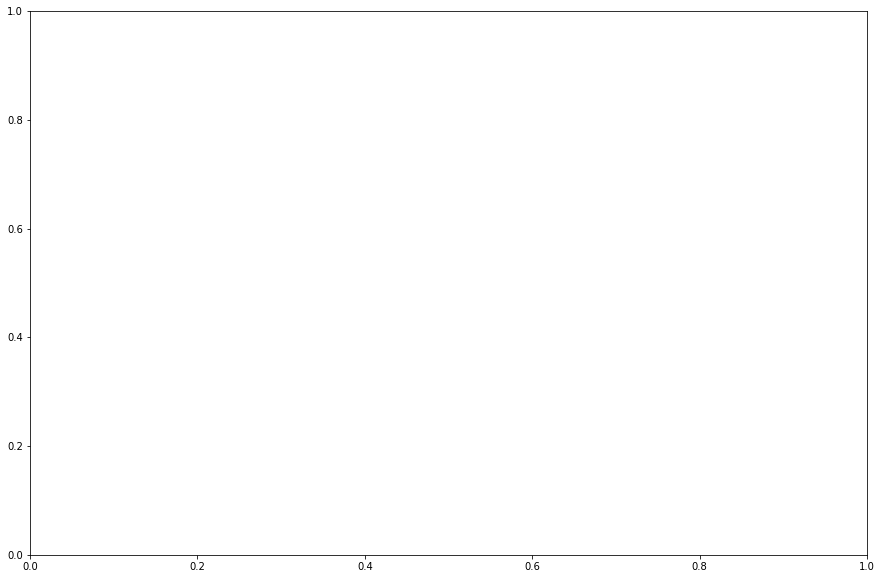

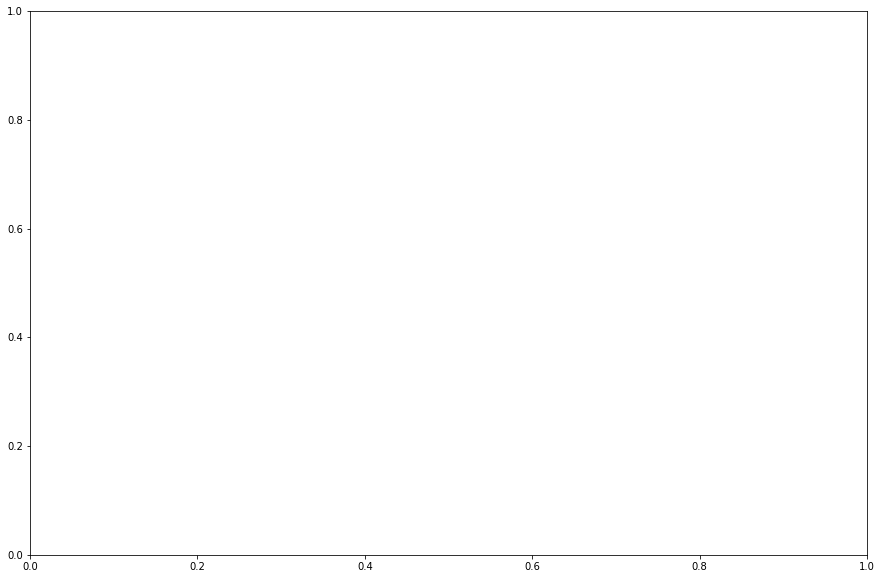

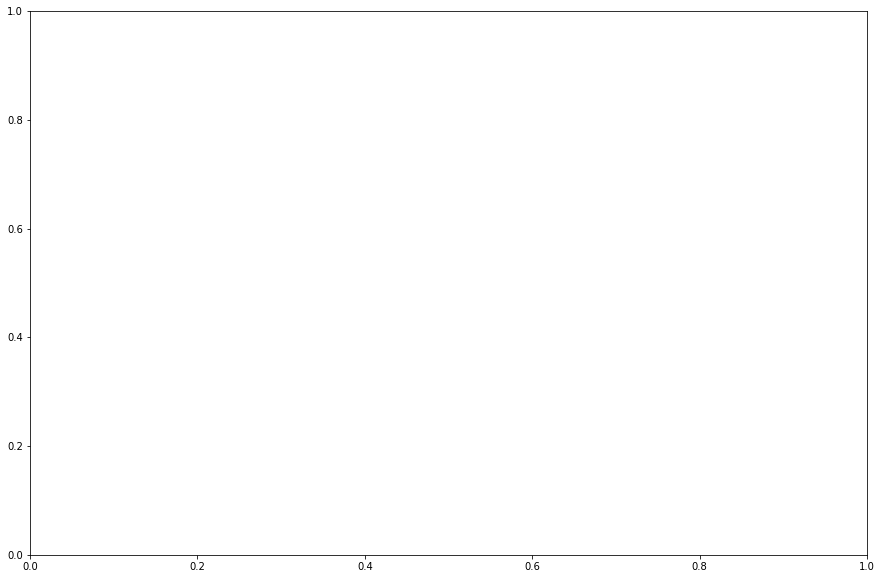

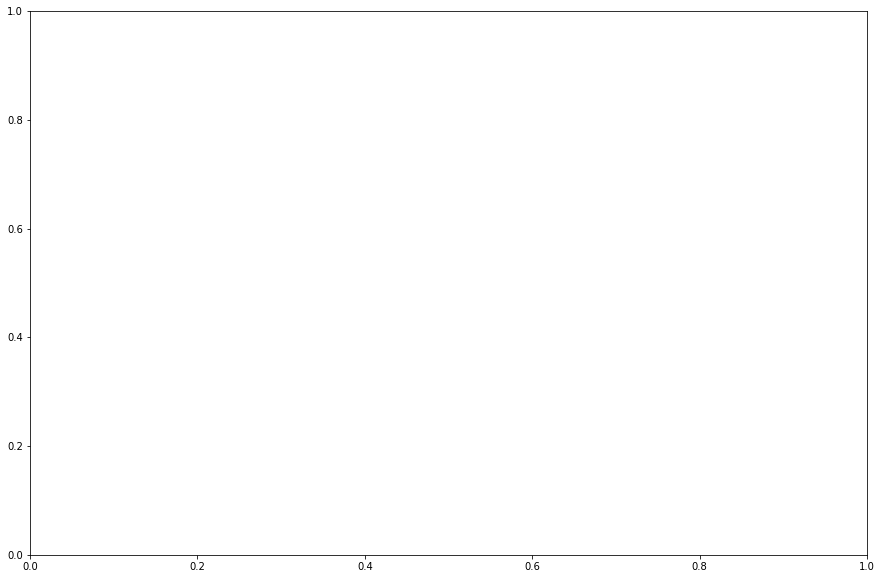

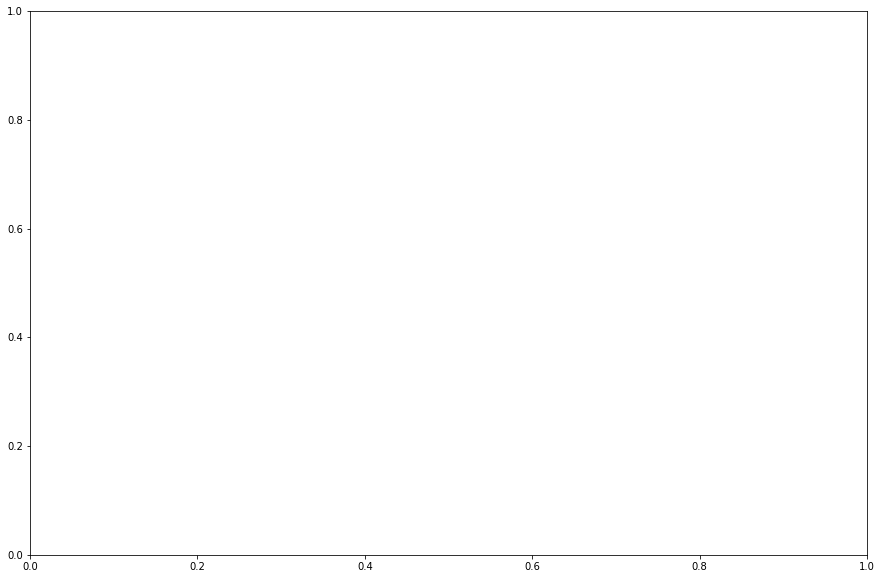

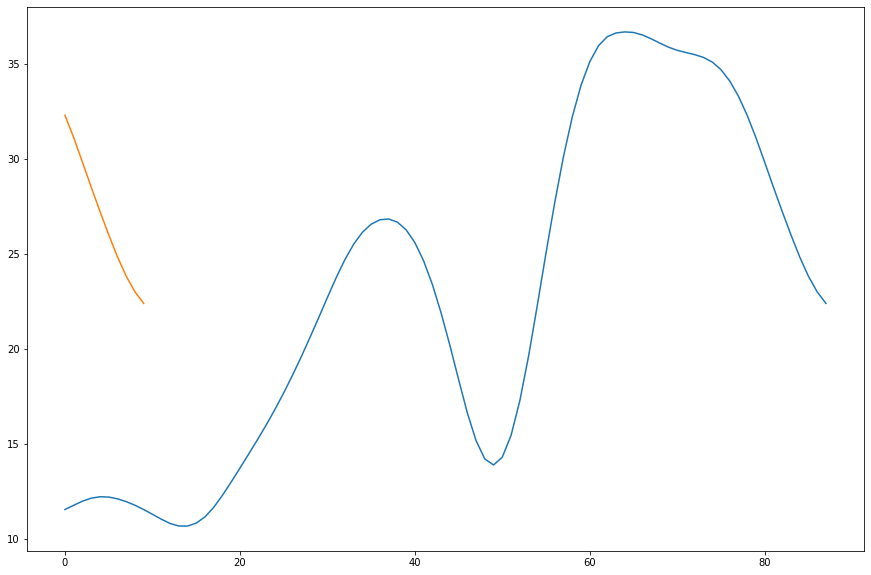

In [60]:
#### PLOT top camera tail angle and compute mean
MouseID_key = ['M48', 'M49', 'M50', 'M51', 'M52', 'M53', 'M54', 'M55', 'M56', 'M57', 'M58', 'M59', 'M60', 'M61', 'M62']
search_key = ['4mm', '5mm', '8mm', '10mm', '15mm', '45mm']
dict_TA_topcam_mean = defaultdict(dict)


for k in np.arange(len(search_key)):    
    fig, ax1 = plt.subplots(1, 1, figsize=(15,10))
    dict_ridge_Xwidth = dict_preprocessed_all[search_key[k]]
    values_list = list(dict_ridge_Xwidth.values())
    key_list = list(dict_ridge_Xwidth.keys()) 
    TA_topcam_mean_list = []
    for i in np.arange(len(key_list)):
        #print(len(values_list[i]))
        TA_traj_wrt_step = values_list[i][-1] #no of last attached array of values
        for j in np.arange(len(TA_traj_wrt_step)):
            plt.plot(TA_traj_wrt_step[j][16]) #no corresponding to top cam TA angle trace
            TA_topcam_mean_list.append(TA_traj_wrt_step[j][15]) #no corresponding to top cam TA angle mean
    dict_TA_topcam_mean[search_key[k]] = TA_topcam_mean_list

In [61]:
#Compute first nonNaN value of array
def firstNonNan(listfloats):
    for item in listfloats:
        if math.isnan(item) == False:
            return item

C:\Program Files\Anaconda3\lib\site-packages\ipykernel_launcher.py:21: RuntimeWarning: Mean of empty slice


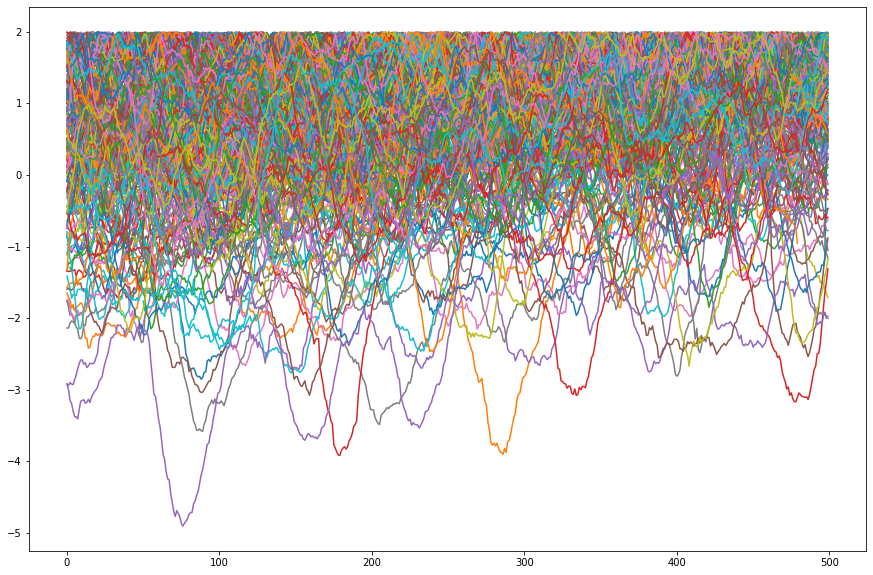

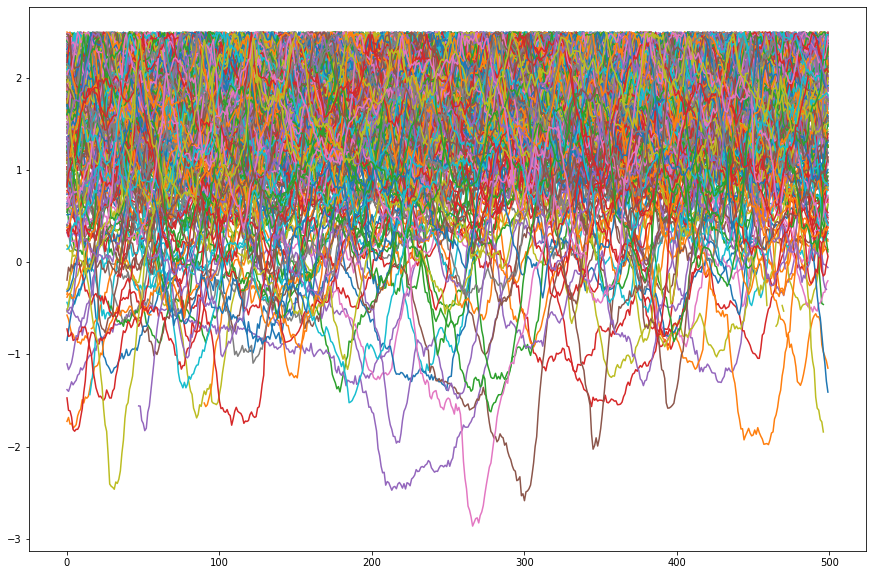

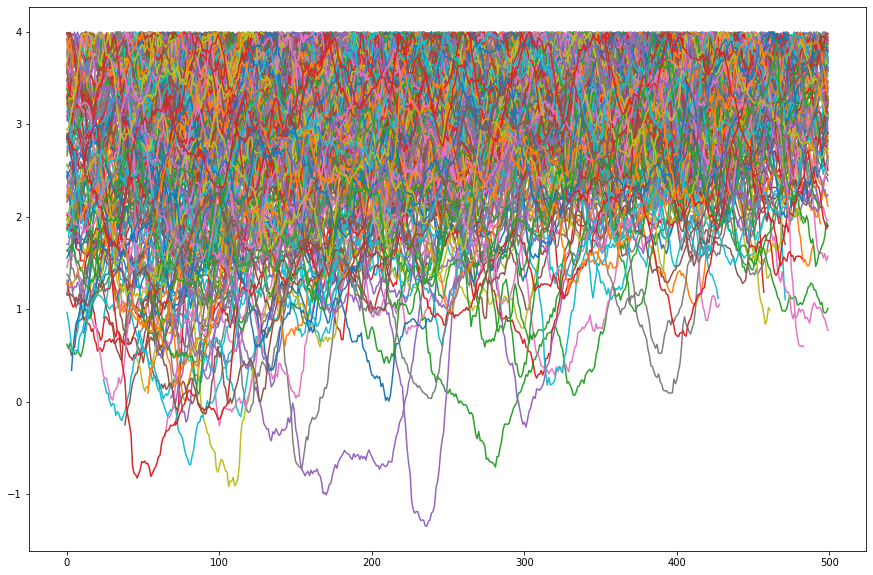

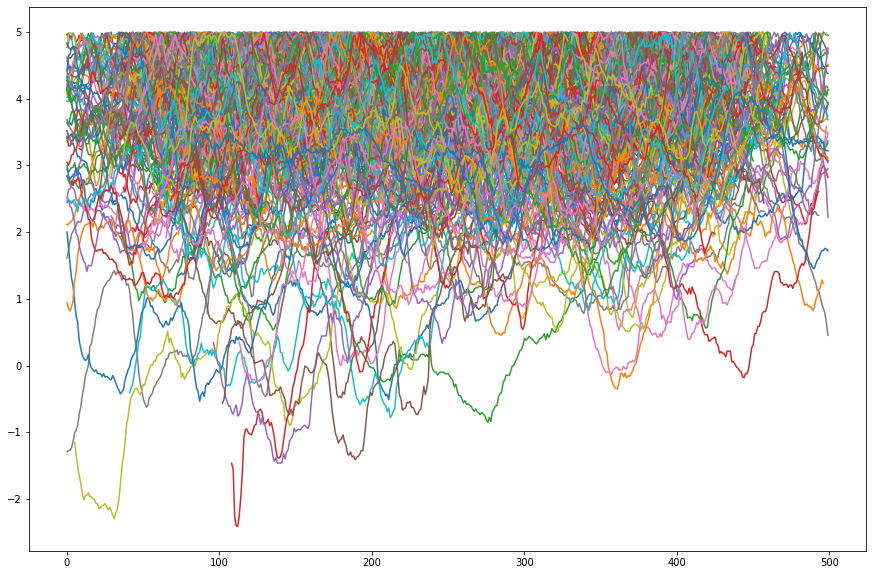

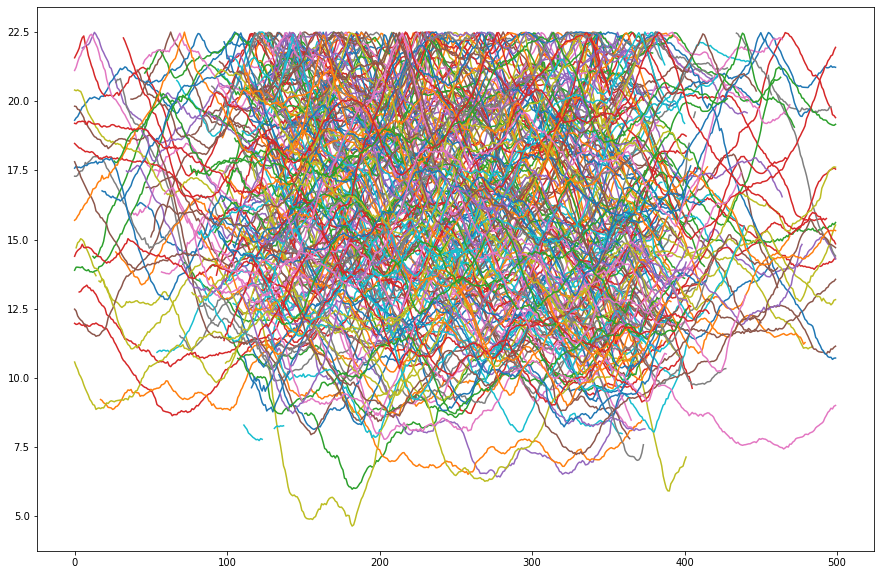

In [62]:
#Plot and compute distance of Centroid X from edges of ridge
search_key = ['4mm', '5mm', '8mm', '10mm', '45mm']
threshold_comx = [10, 10, 10, 12, 30]
dist_from_edge = [2, 2.5, 4, 5, 22.5]
scaling_pixels = [4/5, 5/6, 8/10, 10/12, 45/60]#to convert pixel unit to mm
dict_cent_dist = defaultdict(dict)

for j in np.arange(len(search_key)):
    fig, ax1 = plt.subplots(1, 1, figsize=(15,10))
    bla = dict_ridge_all[search_key[j]]
    values_list = list(bla.values())
    key_list = list(bla.keys())
    cent_dist_list = []
    for i in np.arange(len(key_list)-1):
        cent_dist_traj = values_list[i][22]
        cent_dist_traj_nonNaN = cent_dist_traj[np.logical_not(numpy.isnan(cent_dist_traj))]
        if all(cent_dist_traj_nonNaN < threshold_comx[j]):
            #Compute distance from ridge edge, with neg outside of edge
            cent_dist_from_edge_traj = -(cent_dist_traj*scaling_pixels[j])+dist_from_edge[j]
            plt.plot(cent_dist_from_edge_traj)
            cent_dist_list.append(np.nanmean(cent_dist_from_edge_traj))
    dict_cent_dist[search_key[j]] = cent_dist_list
    #plt.ylim(-5, 5)

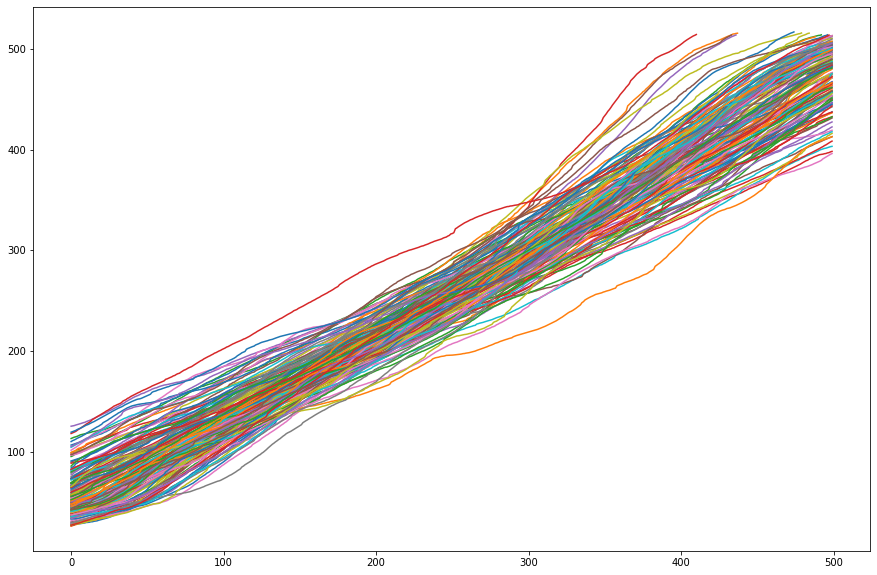

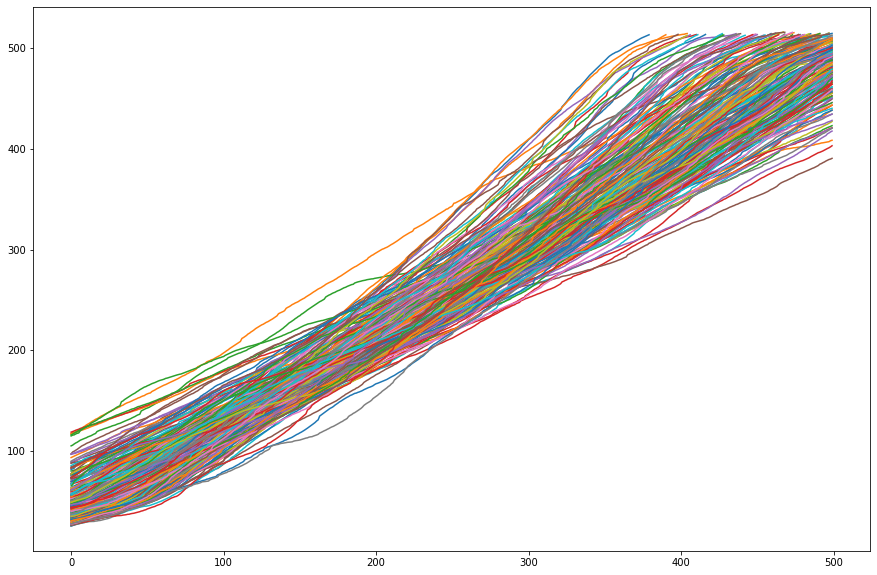

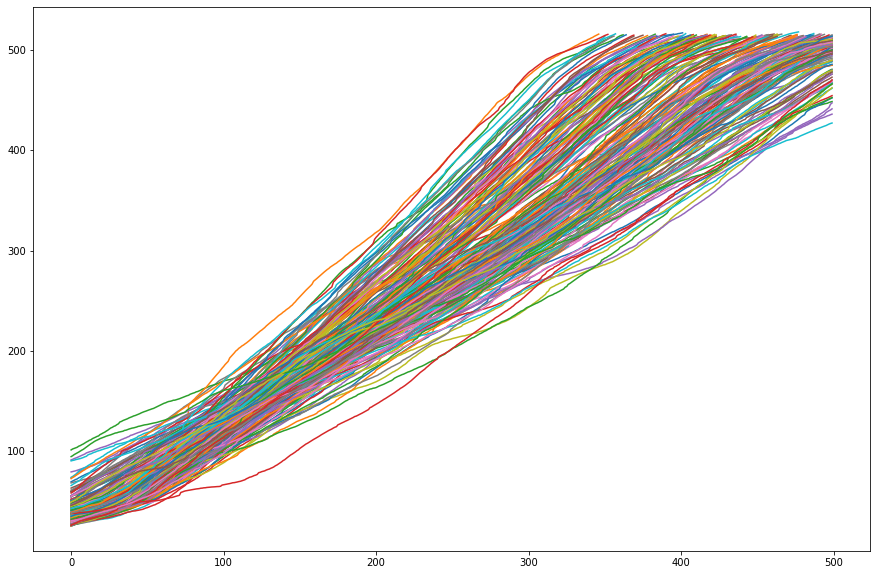

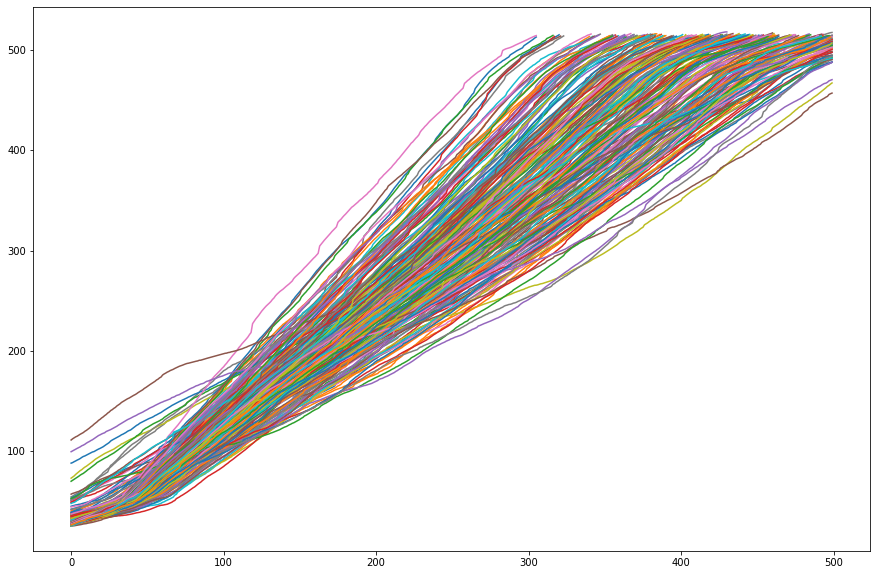

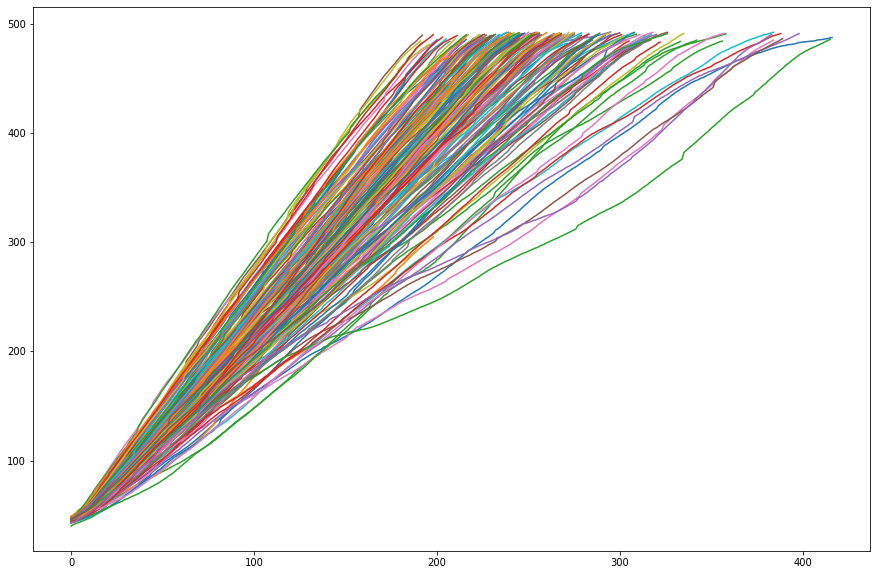

In [63]:
#Plot forward velocity and insert value in dict
search_key = ['4mm', '5mm', '8mm', '10mm', '45mm']
dict_vel = defaultdict(dict)

for j in np.arange(len(search_key)):
    fig, ax1 = plt.subplots(1, 1, figsize=(15,10))
    bla = dict_ridge_all[search_key[j]]
    values_list = list(bla.values())
    key_list = list(bla.keys())
    vel_list = []
    for i in np.arange(len(key_list)-1):
        comy_traj = values_list[i][21]
        comy_traj_nonNaN = comy_traj[np.logical_not(numpy.isnan(comy_traj))]
        if all(np.diff(comy_traj_nonNaN)>0) and len(comy_traj_nonNaN):
            comy_traj_seg = comy_traj_nonNaN
            #Compute first and last nonNan value from CentY and velocity
            centY_nonNan_first = comy_traj_seg[0]
            centY_nonNan_last = comy_traj_seg[-1]
            vel_centY = ((centY_nonNan_last-centY_nonNan_first)*scaling_pixels[j])/(((len(comy_traj_seg))*(1/300))*1000)#scaling m/s
            plt.plot(comy_traj_seg)#-centY_nonNan)
            #Take avg of 1st and last segments of Centroid trace and compute differences of idx 
            vel_list.append(vel_centY)
    dict_vel[search_key[j]] = vel_list

C:\Program Files\Anaconda3\lib\site-packages\ipykernel_launcher.py:21: RuntimeWarning: Mean of empty slice


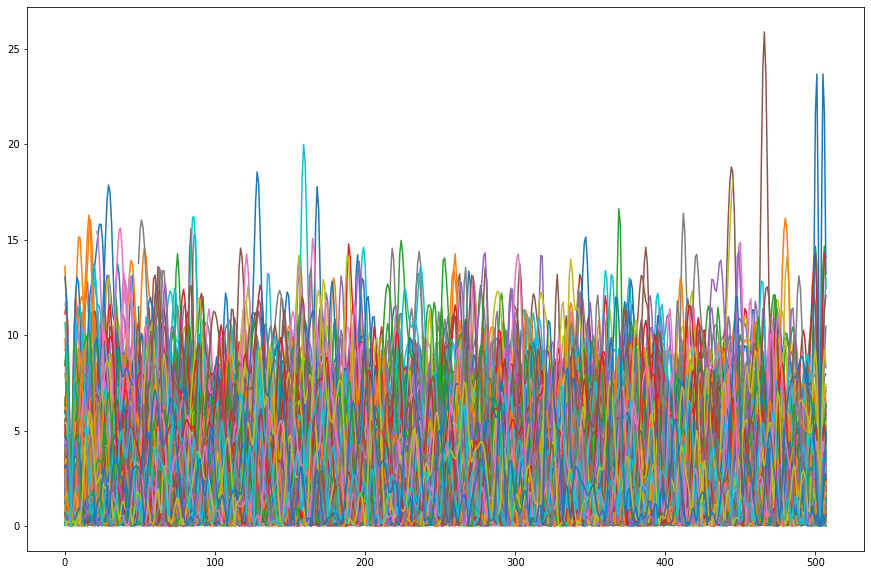

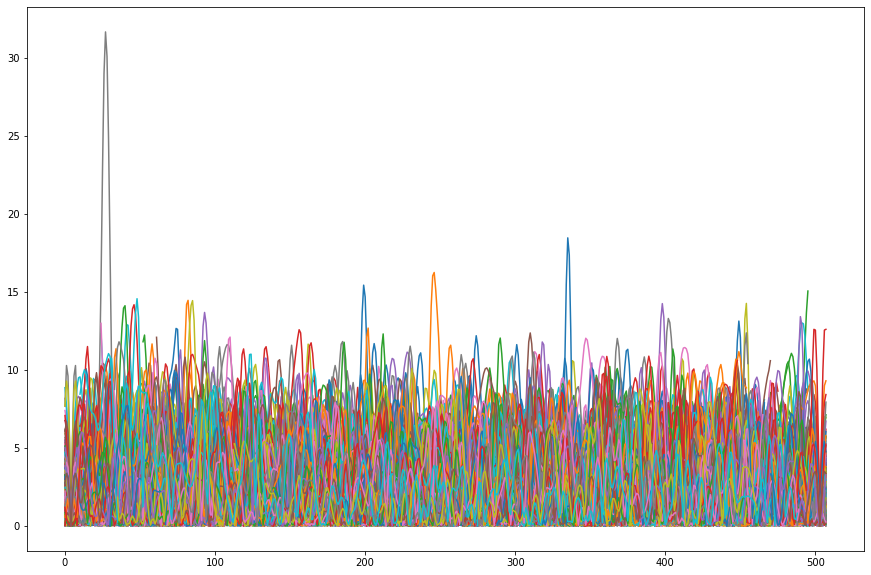

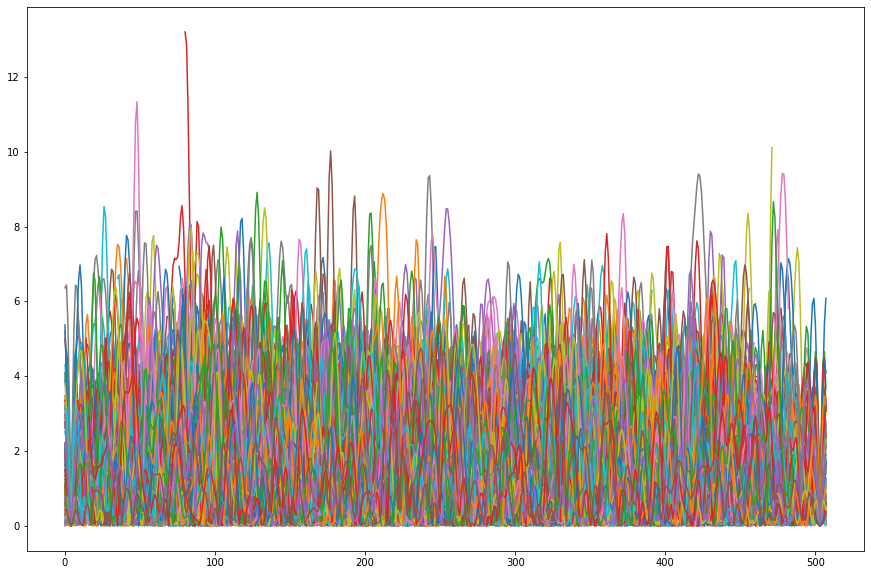

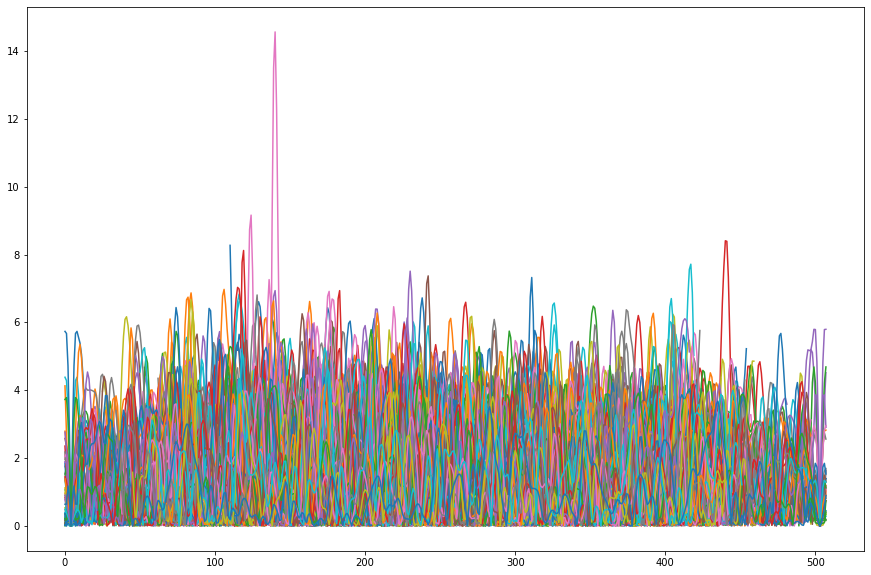

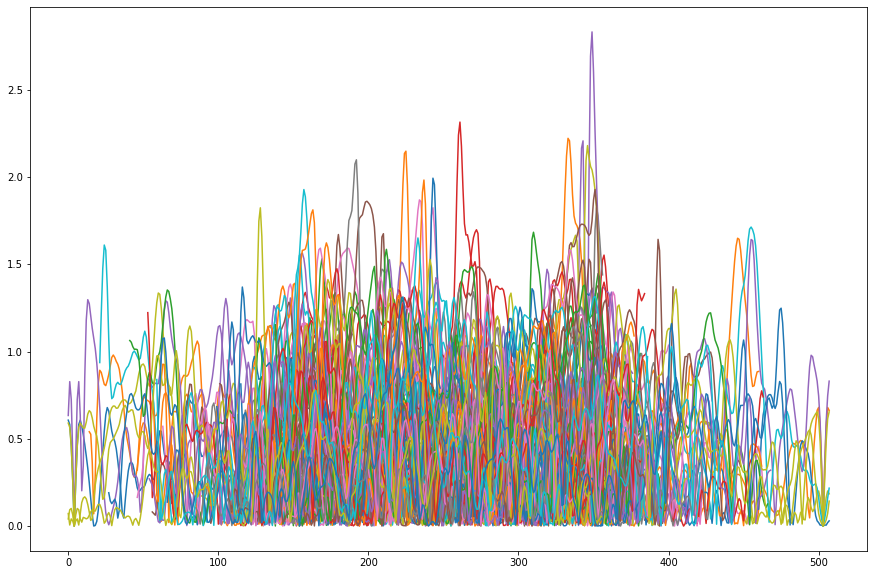

In [64]:
#Plot CentroidX and compute average distance from midline
search_key = ['4mm', '5mm', '8mm', '10mm', '45mm']
scaling_pixels = [4/5, 5/6, 8/10, 10/12, 45/60]#to convert pixel unit to mm
scaling_factor = [4, 5, 8, 10, 45] #divide by this number to get relative distance from midline

dict_CentX = defaultdict(dict)

for j in np.arange(len(search_key)):
    fig, ax1 = plt.subplots(1, 1, figsize=(15,10))
    bla = dict_ridge_all[search_key[j]]
    values_list = list(bla.values())
    key_list = list(bla.keys())
    CentX_traj_list = []
    for i in np.arange(len(key_list)-1):
        CentX_traj = (smooth(values_list[i][22], 10))*scaling_pixels[j] #Given that movement of interes is around 30 ms I take a smooth window of 10
        CentX_traj_rel = abs(np.diff(CentX_traj/scaling_factor[j]))
        CentX_traj_vel_metpersec = CentX_traj_rel*(300)
        CentX_traj_nonNaN = CentX_traj[np.logical_not(numpy.isnan(CentX_traj))]
        if j <5 and all(CentX_traj_nonNaN<10):
            plt.plot(CentX_traj_vel_metpersec)
            CentX_traj_list.append(np.nanmean(CentX_traj_vel_metpersec))
        elif j ==5:
            plt.plot(CentX_traj_vel_metpersec)
            CentX_traj_list.append(np.nanmean(CentX_traj_vel_metpersec))
    #plt.ylim(-10, 10)
    dict_CentX[search_key[j]] = CentX_traj_list

C:\Program Files\Anaconda3\lib\site-packages\ipykernel_launcher.py:21: RuntimeWarning: Mean of empty slice


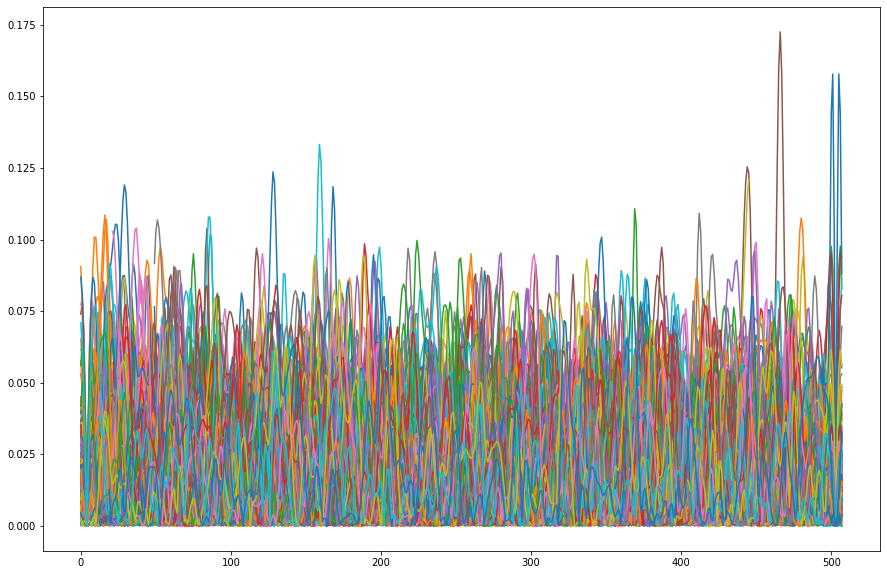

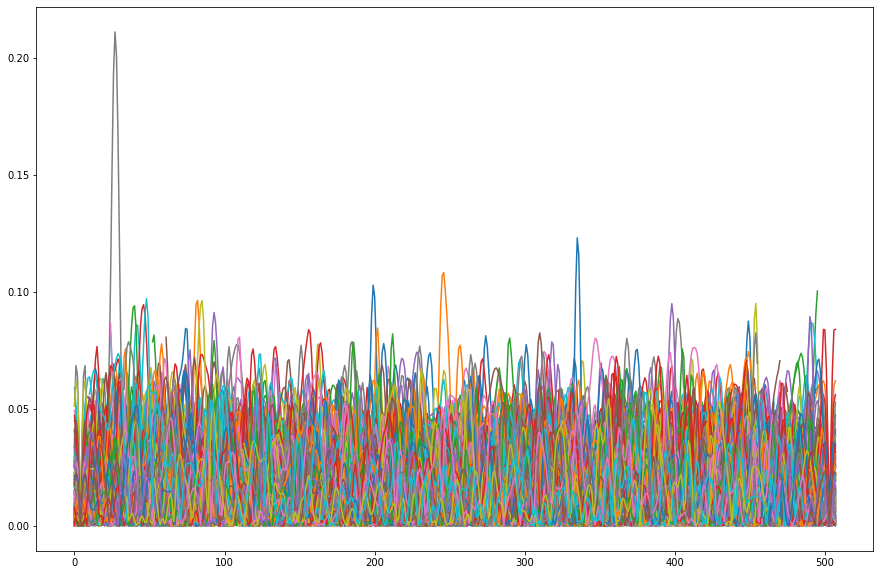

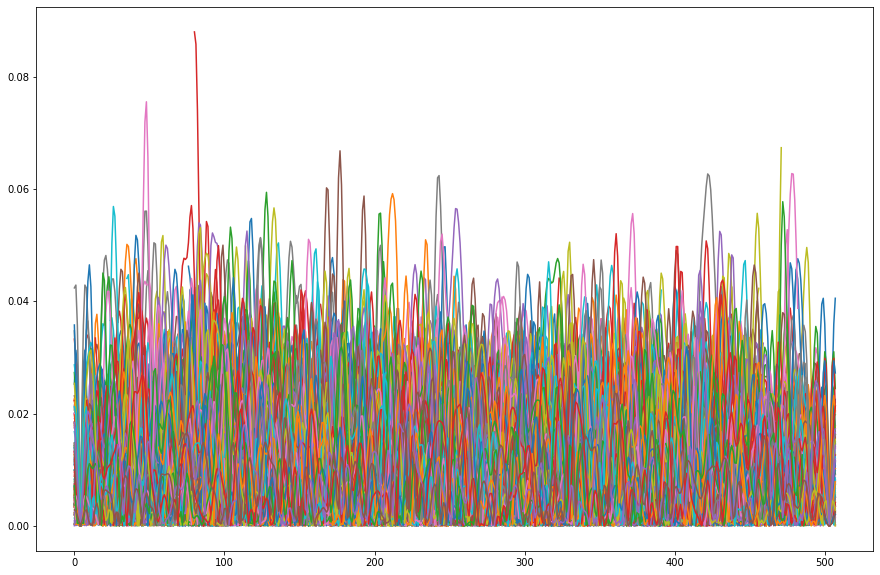

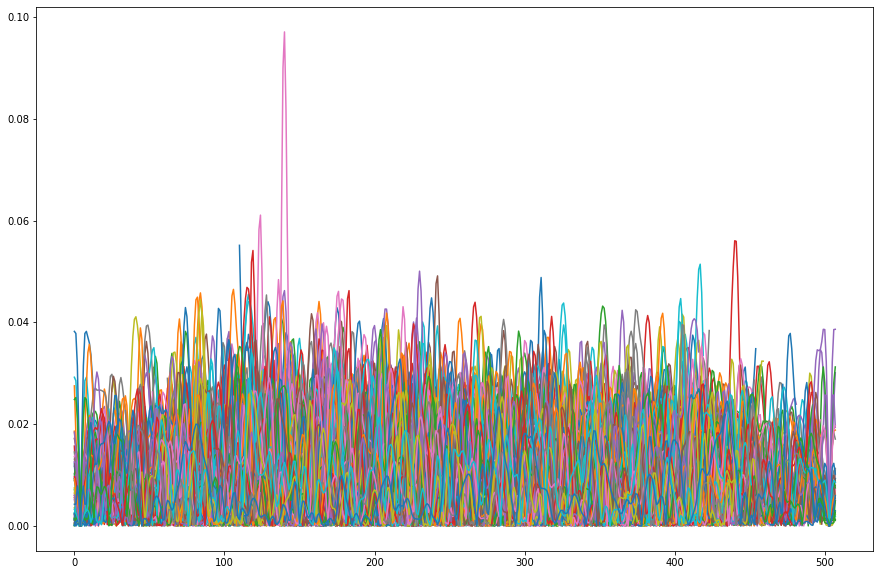

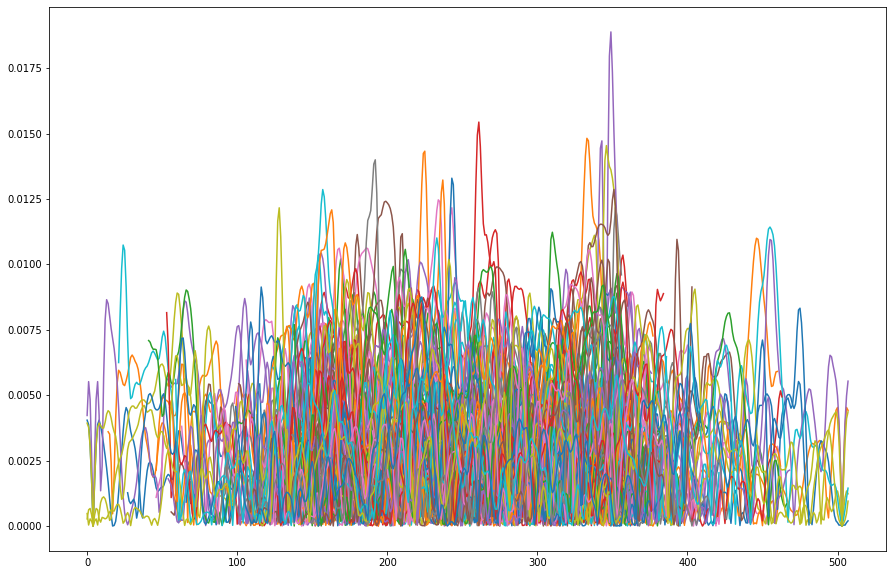

In [65]:
#Plot distance from midline and compute average velocity of distance from midline 
search_key = ['4mm', '5mm', '8mm', '10mm', '45mm']
scaling_pixels = [4/5, 5/6, 8/10, 10/12, 45/60]#to convert pixel unit to mm
scaling_factor = [2, 2.5, 4, 5, 22.5] #divide by this number to get relative distance from midline

dict_CentX = defaultdict(dict)

for j in np.arange(len(search_key)):
    fig, ax1 = plt.subplots(1, 1, figsize=(15,10))
    bla = dict_ridge_all[search_key[j]]
    values_list = list(bla.values())
    key_list = list(bla.keys())
    CentX_traj_list = []
    for i in np.arange(len(key_list)-1):
        CentX_traj = ((smooth(values_list[i][22], 10))*scaling_pixels[j])#Convert to mm
        CentX_traj_rel = abs(np.diff(CentX_traj/scaling_factor[j]))
        CentX_traj_vel_metpersec = CentX_traj_rel/(1/300) #convert to mm/s
        CentX_traj_nonNaN = CentX_traj[np.logical_not(numpy.isnan(CentX_traj))]
        if j <5 and all(CentX_traj_nonNaN<10):
            plt.plot(CentX_traj_rel)
            CentX_traj_list.append(np.nanmean(CentX_traj_vel_metpersec))
        elif j == 5:
            plt.plot(CentX_traj_rel)
            CentX_traj_list.append(np.nanmean(CentX_traj_vel_metpersec))
    #plt.ylim(-10, 30)
    dict_CentX[search_key[j]] = CentX_traj_list

C:\Program Files\Anaconda3\lib\site-packages\ipykernel_launcher.py:21: RuntimeWarning: Mean of empty slice


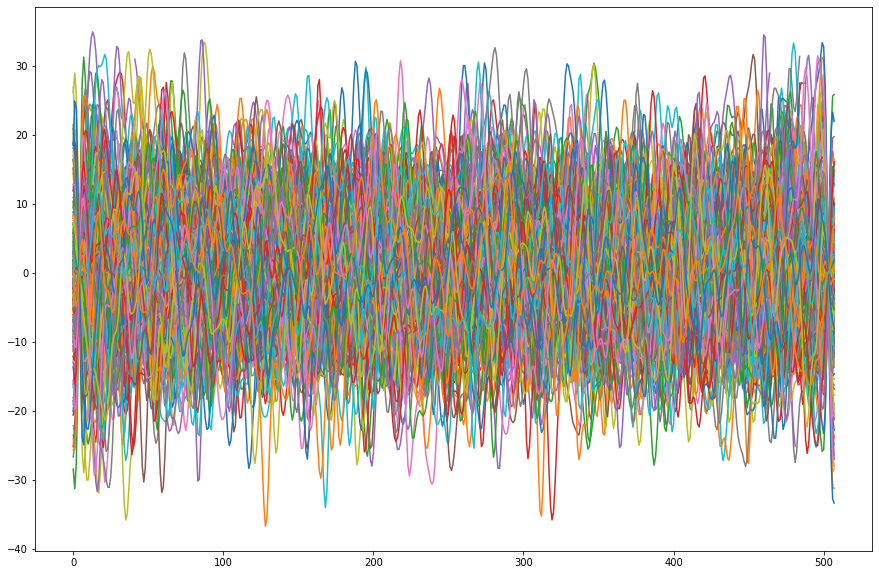

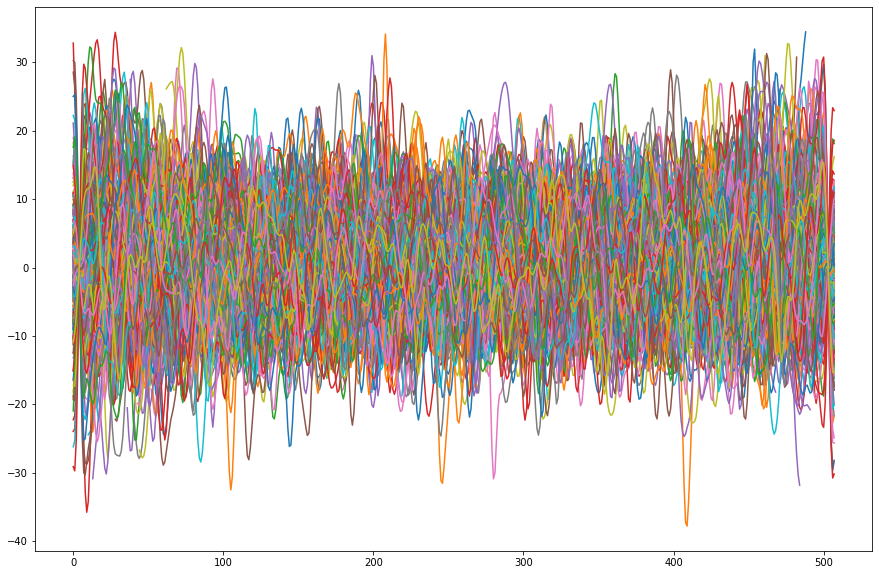

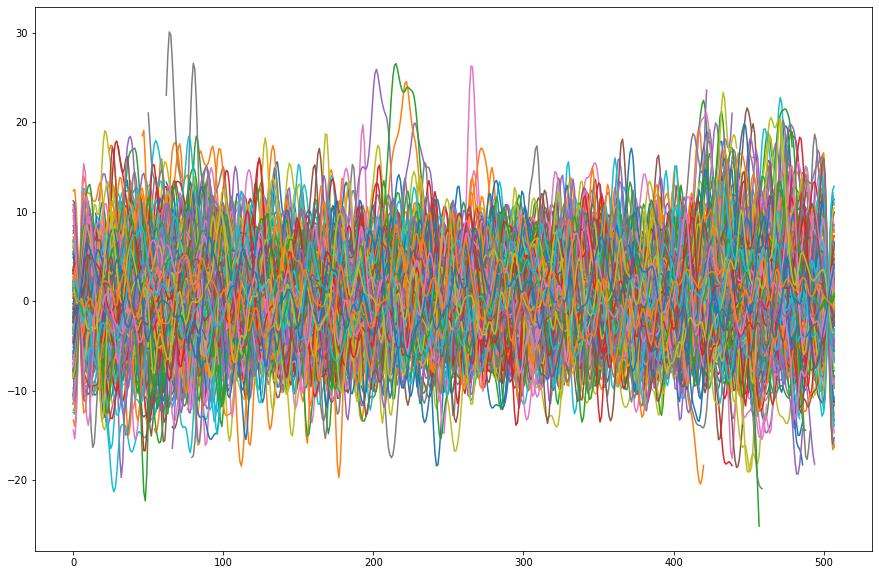

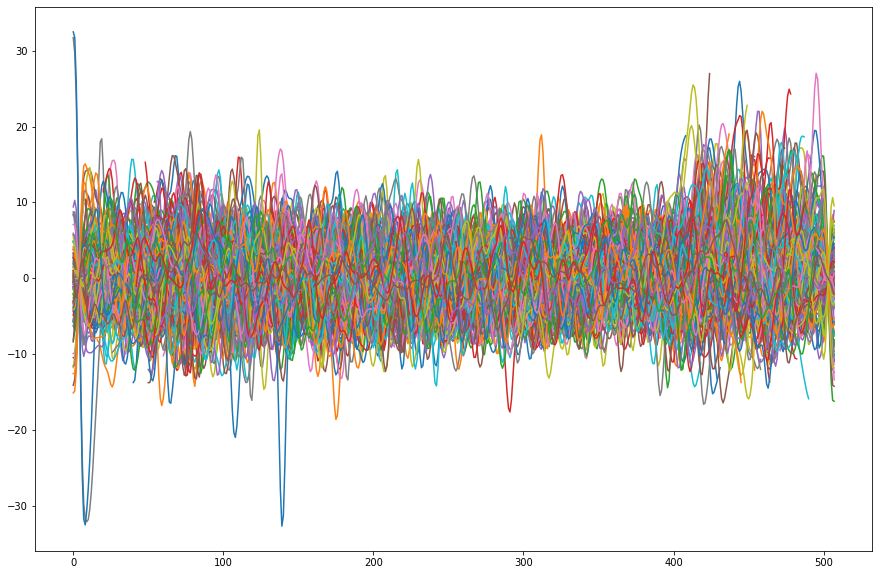

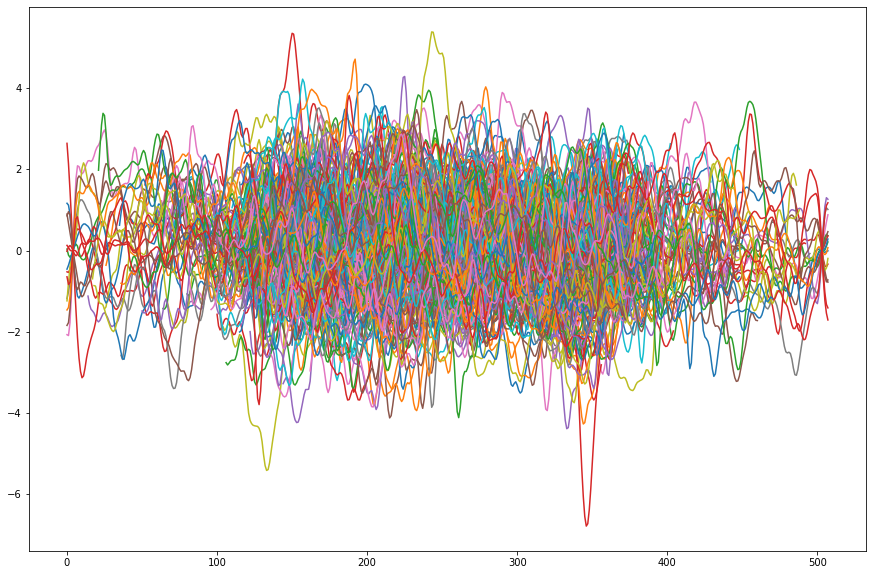

In [66]:
#Plot CentroidX and compute average velocity of CentroidX (horizontal sway)
search_key = ['4mm', '5mm', '8mm', '10mm', '45mm']
scaling_pixels = [4/5, 5/6, 8/10, 10/12, 45/60]#to convert pixel unit to mm
scaling_factor = [2, 2.5, 4, 5, 22.5] #divide by this number to get relative distance from midline

dict_CentX = defaultdict(dict)

for j in np.arange(len(search_key)):
    fig, ax1 = plt.subplots(1, 1, figsize=(15,10))
    bla = dict_ridge_all[search_key[j]]
    values_list = list(bla.values())
    key_list = list(bla.keys())
    CentX_traj_list = []
    for i in np.arange(len(key_list)-1):
        CentX_traj = (smooth(values_list[i][2], 10))*scaling_pixels[j]#Convert to mm
        CentX_traj_rel = np.diff(CentX_traj/scaling_factor[j])
        CentX_traj_vel_metpersec = CentX_traj_rel/(1/300) #convert to mm/s
        CentX_traj_vel_metpersec_nonNaN = CentX_traj_vel_metpersec[np.logical_not(numpy.isnan(CentX_traj_vel_metpersec))]
        if j <4 and all(CentX_traj_vel_metpersec_nonNaN <35) and all(CentX_traj_vel_metpersec_nonNaN >-40):
            plt.plot(CentX_traj_vel_metpersec)
            CentX_traj_list.append(np.nanmean(CentX_traj_vel_metpersec_nonNaN))
        elif j == 4:
            plt.plot(CentX_traj_vel_metpersec)
            CentX_traj_list.append(np.nanmean(CentX_traj_vel_metpersec_nonNaN))
    #plt.ylim(-0.5, 0.5)
    dict_CentX[search_key[j]] = CentX_traj_list

211
90
8
9


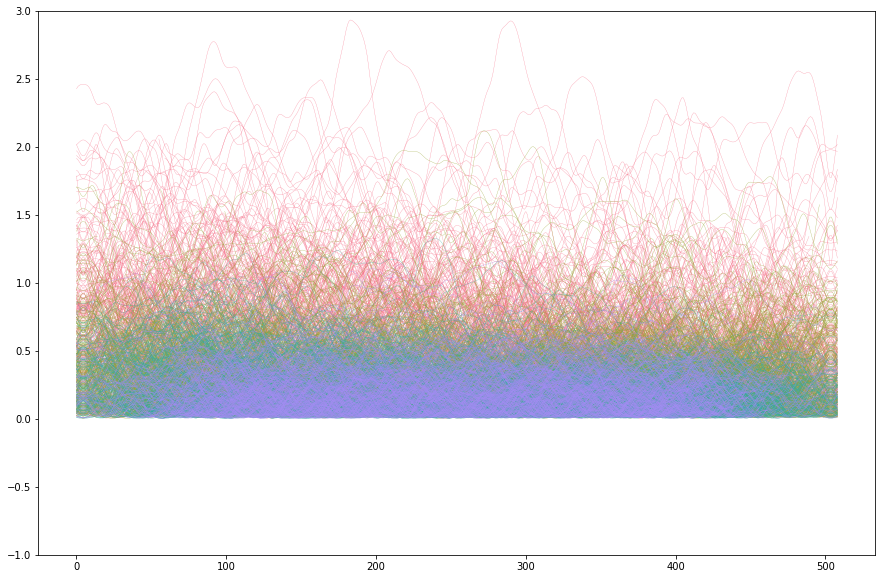

In [67]:
#Count no of trials mice COM goes outside of the ridge
search_key = ['4mm', '5mm', '8mm', '10mm']#, '45mm']
scaling_pixels = [4/5, 5/6, 8/10, 10/12, 45/60]#to convert pixel unit to mm
scaling_factor = [2, 2.5, 4, 5] #divide by this number to get relative distance from midline
clrs = sns.color_palette("husl", 4)

dict_CentX = defaultdict(dict)
fig, ax1 = plt.subplots(1, 1, figsize=(15,10))
for j in np.arange(len(search_key)):
    #fig, ax1 = plt.subplots(1, 1, figsize=(15,10))
    bla = dict_ridge_all[search_key[j]]
    values_list = list(bla.values())
    key_list = list(bla.keys())
    CentX_traj_list = []
    a = 0
    for i in np.arange(len(key_list)-1):
        CentX_traj = (smooth(values_list[i][22], 10))*scaling_pixels[j] #Given that movement of interes is around 30 ms I take a smooth window of 10
        CentX_traj_rel = CentX_traj/scaling_factor[j]
        CentX_traj_vel_metpersec = CentX_traj_rel#*(300)
        CentX_traj_nonNaN = CentX_traj[np.logical_not(numpy.isnan(CentX_traj))]
        if j <5 and all(CentX_traj_nonNaN<6):# and len(CentX_traj_vel_metpersec) == 509:
            plt.plot(CentX_traj_vel_metpersec, c = clrs[j], lw=0.3, alpha = 0.8)
            count_outCOM = np.where(CentX_traj_vel_metpersec > 1, 1, 0)
            sum_count_outCOM = np.sum(count_outCOM)
            perc_time_p_outCOM = sum_count_outCOM/500
            if sum_count_outCOM>10:
                a = a+1
#            non_nan_array = CentX_traj_vel_metpersec[~np.isnan(CentX_traj_vel_metpersec)]
#             if len(non_nan_array[100:400]) == 300:
#                 CentX_traj_list.append(non_nan_array[100:400])
#         elif j ==5:
#             plt.plot(CentX_traj_vel_metpersec)
#             CentX_traj_list.append(CentX_traj_vel_metpersec)
    print(a)
    plt.ylim(-1, 3)
    dict_CentX[search_key[j]] = CentX_traj_list

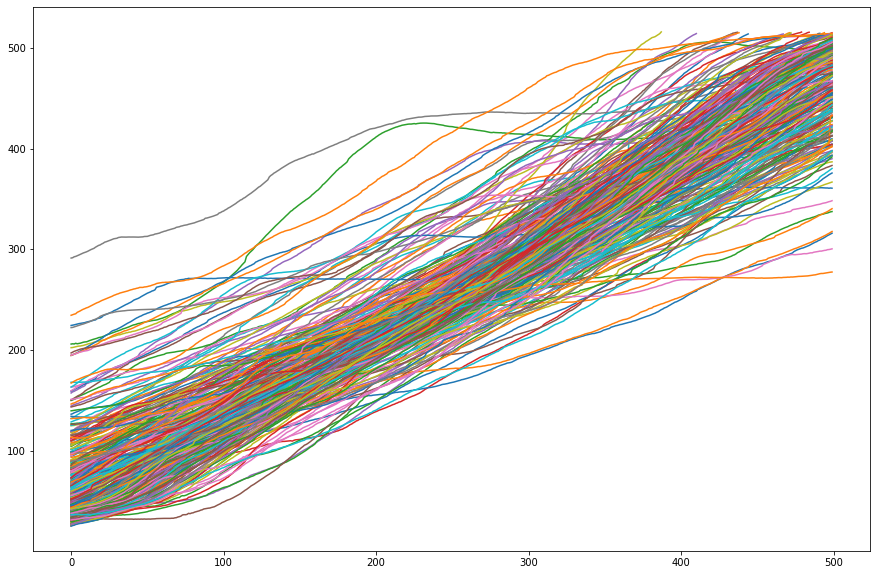

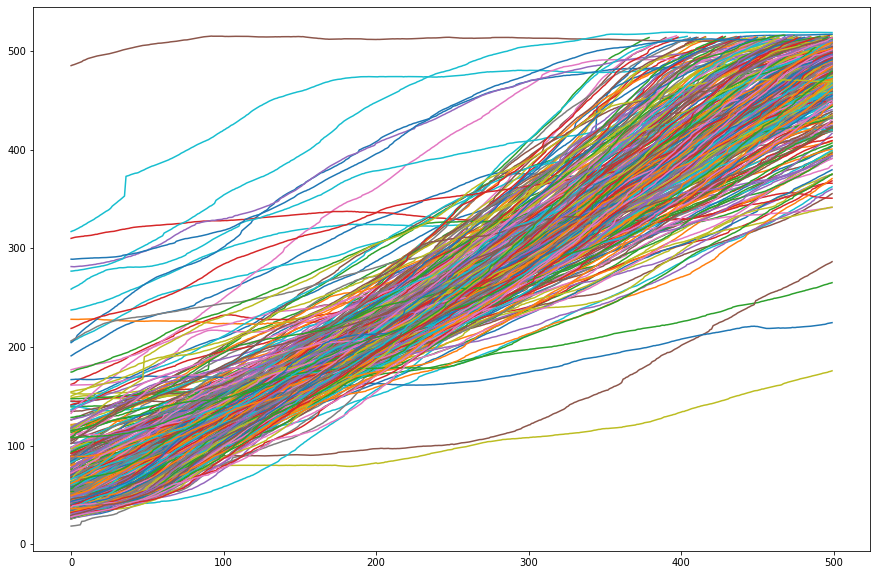

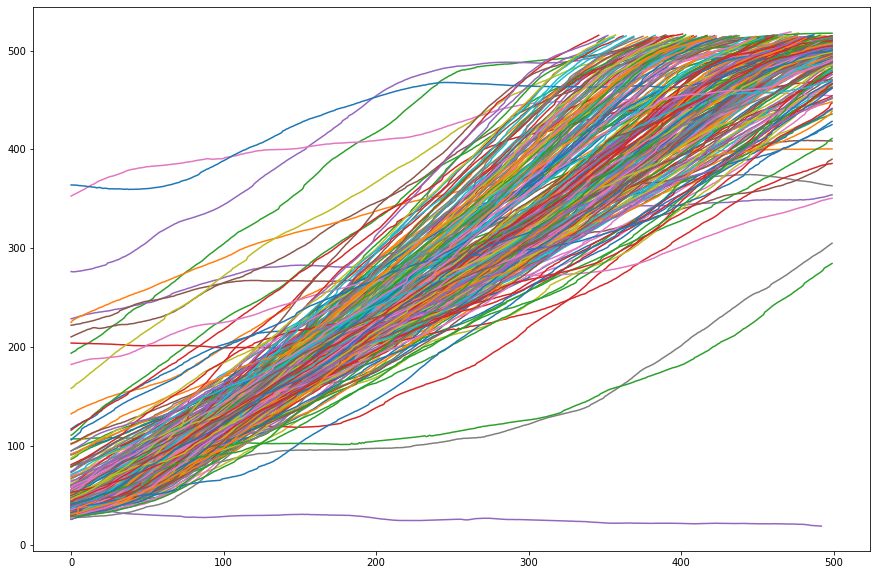

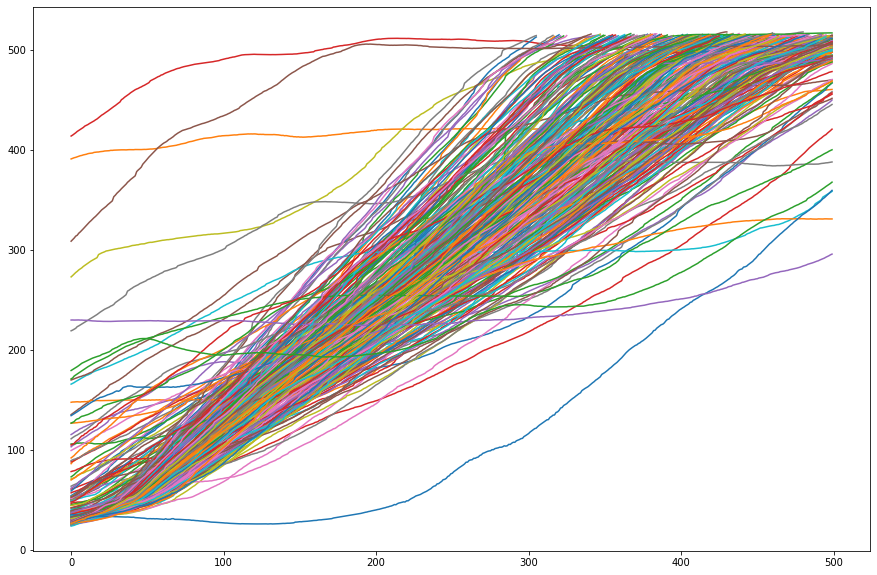

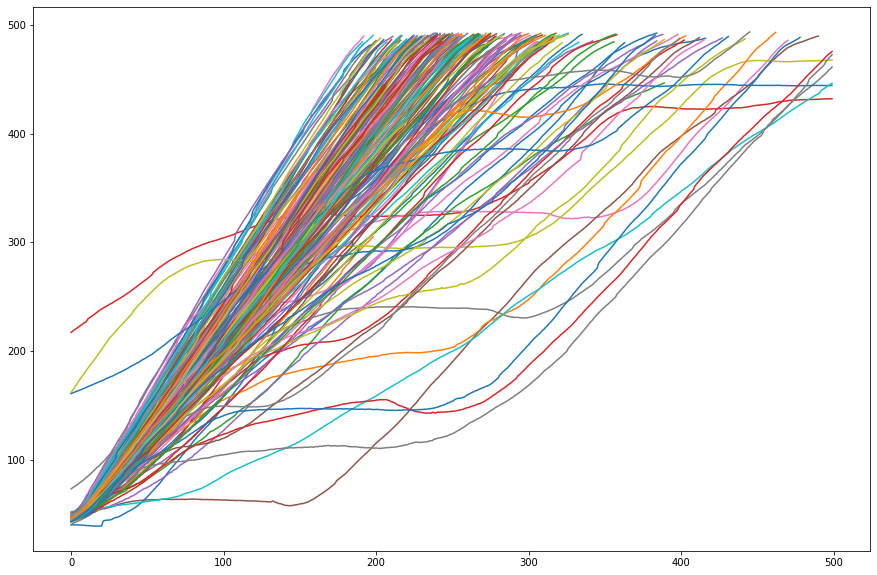

In [68]:
#Count fwd speed divided by Mouse ID *******************************
search_key = ['4mm', '5mm', '8mm', '10mm', '45mm']
MouseID_key = ['M48', 'M49', 'M50', 'M51', 'M52', 'M53', 'M54', 'M55', 'M56', 'M57', 'M58', 'M59', 'M60', 'M61', 'M62']

ridge_half_widths = [2.5, 3, 5, 6]
scaling_pixels = [4/5, 5/6, 8/10, 10/12, 45/60]#to convert pixel unit to mm
clrs = sns.color_palette("husl", 4)

dict_perc_time_p_outCOM = defaultdict(dict)
#fig, ax1 = plt.subplots(1, 1, figsize=(15,10))
for j in np.arange(len(search_key)):
    fig, ax1 = plt.subplots(1, 1, figsize=(15,10))
    vel_list_mouseID = []
    for k in np.arange(len(MouseID_key)):
        #fig, ax1 = plt.subplots(1, 1, figsize=(15,10))
        dict_ridge_Xwidth = dict_ridge_all[search_key[j]]
        dict_ridge_XwidthXmouseID = dict(filter(lambda item: MouseID_key[k] in item[0], dict_ridge_Xwidth.items())) 
        values_list = list(dict_ridge_XwidthXmouseID.values())
        key_list = list(dict_ridge_XwidthXmouseID.keys())
        vel_list = []
        for i in np.arange(len(key_list)-1):
            comy_traj = values_list[i][21]
            comy_traj_nonNaN = comy_traj[np.logical_not(numpy.isnan(comy_traj))]
            if all(np.diff(comy_traj_nonNaN)>-0.9) and len(comy_traj_nonNaN):
                comy_traj_seg = comy_traj_nonNaN
                #Compute first and last nonNan value from CentY and velocity
                centY_nonNan_first = comy_traj_seg[0]
                centY_nonNan_last = comy_traj_seg[-1]
                vel_centY = ((centY_nonNan_last-centY_nonNan_first)*scaling_pixels[j])/(((len(comy_traj_seg))*(1/300))*1000)#scaling m/s
                plt.plot(comy_traj_seg)#-centY_nonNan)
                #Take avg of 1st and last segments of Centroid trace and compute differences of idx 
                vel_list.append(vel_centY)
#                 print(len(vel_list))
        vel_list_mouseID.append(np.nanmean(vel_list))
#         print(len(vel_list_mouseID))
        dict_perc_time_p_outCOM[search_key[j]] = vel_list_mouseID
 

C:\Program Files\Anaconda3\lib\site-packages\ipykernel_launcher.py:33: RuntimeWarning: Mean of empty slice


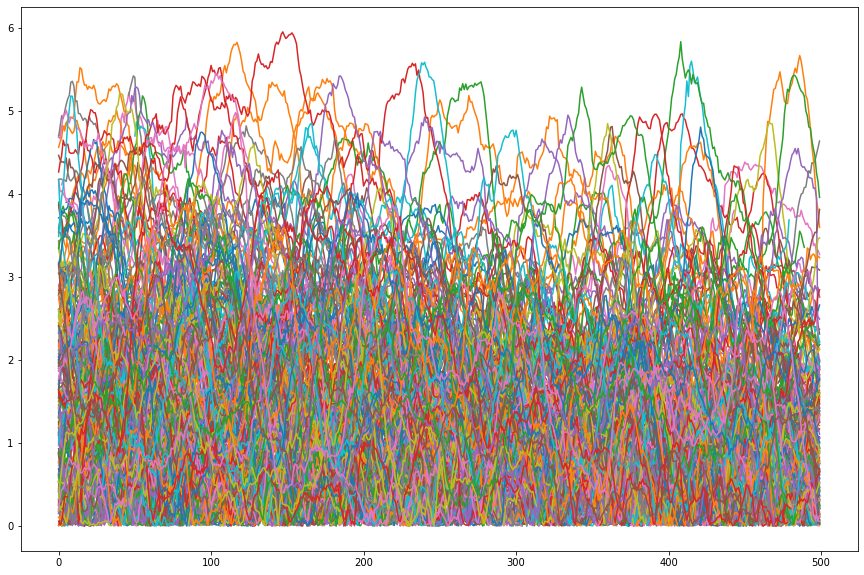

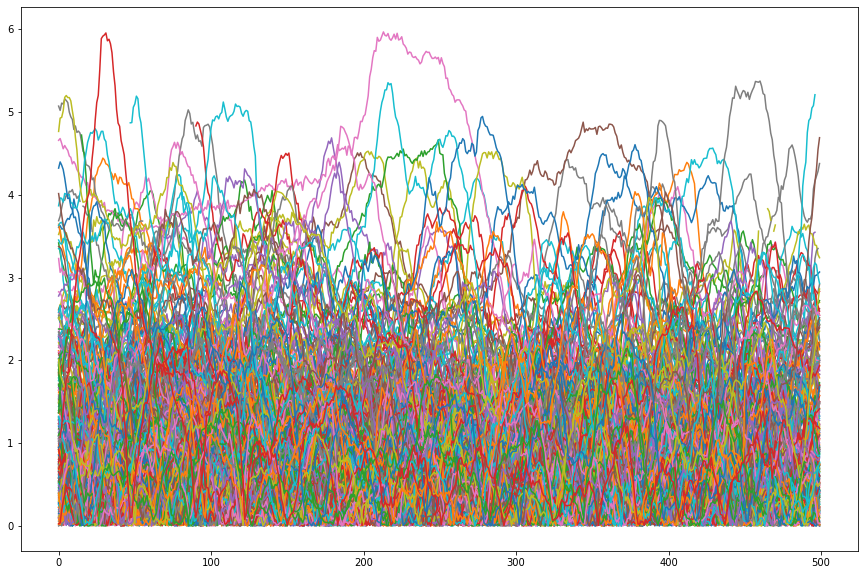

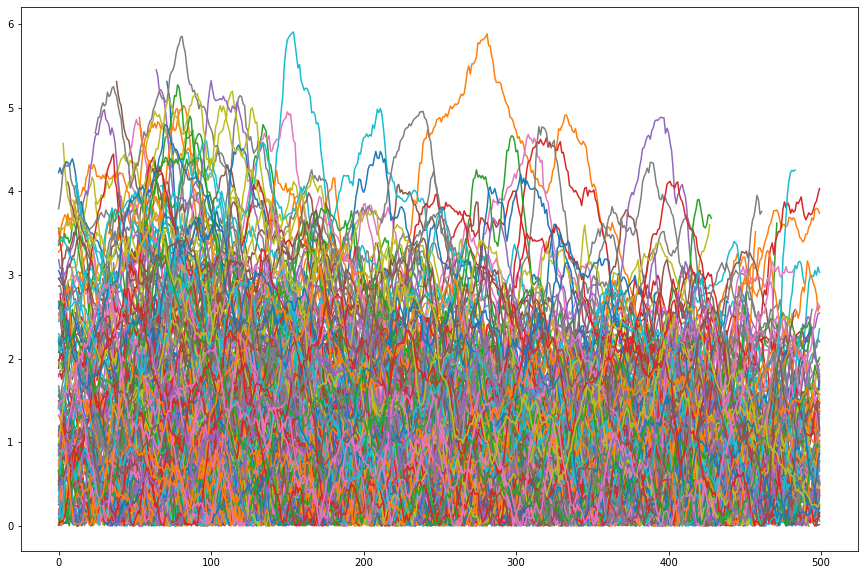

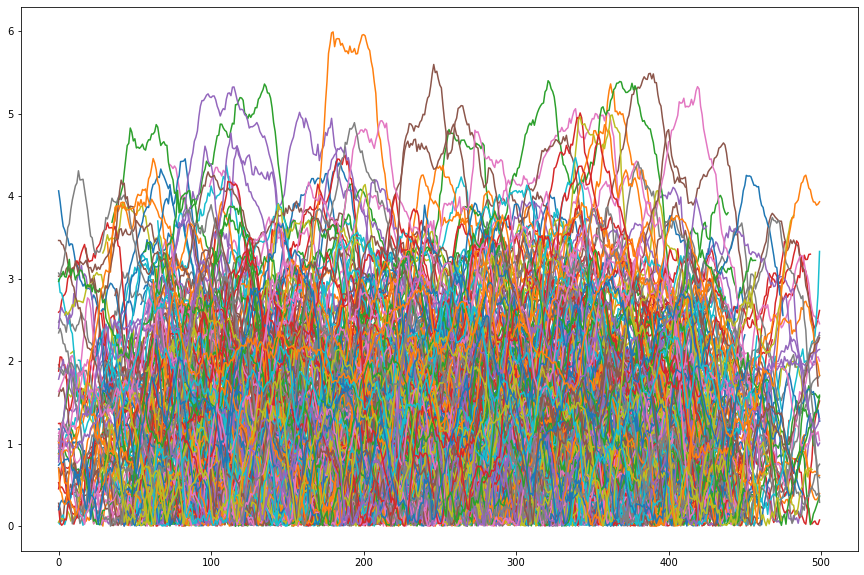

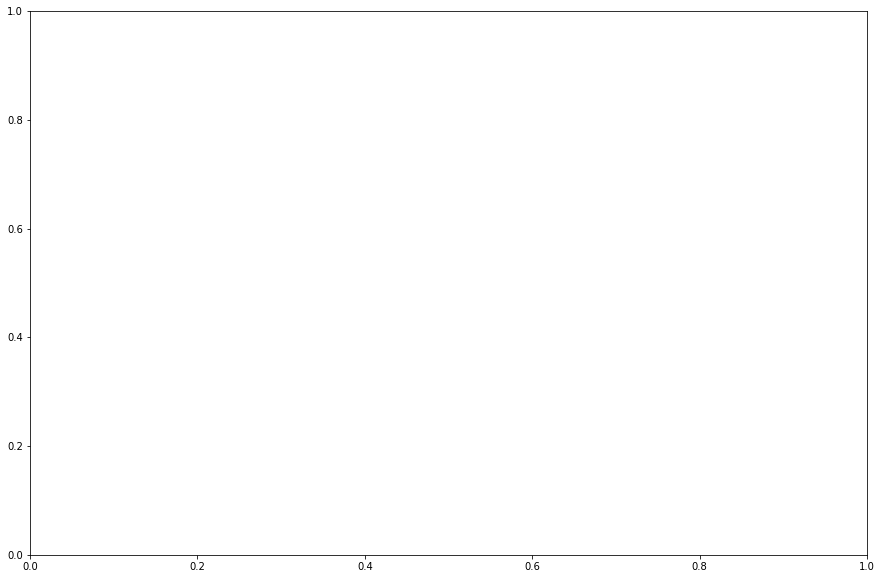

In [69]:
#Count % of trials mice COM within BoS divided by Mouse ID  *******************************
search_key = ['4mm', '5mm', '8mm', '10mm', '45mm']
MouseID_key = ['M48', 'M49', 'M50', 'M51', 'M52', 'M53', 'M54', 'M55', 'M56', 'M57', 'M58', 'M59', 'M60', 'M61', 'M62']

ridge_half_widths = [2.5, 3, 5, 6]
scaling_pixels = [4/5, 5/6, 8/10, 10/12, 45/60]#to convert pixel unit to mm
clrs = sns.color_palette("husl", 4)

dict_perc_time_p_outCOM = defaultdict(dict)
#fig, ax1 = plt.subplots(1, 1, figsize=(15,10))
for j in np.arange(len(search_key)):
    fig, ax1 = plt.subplots(1, 1, figsize=(15,10))
    perc_time_p_outCOM_listMouseID = []
    for k in np.arange(len(MouseID_key)):
        #fig, ax1 = plt.subplots(1, 1, figsize=(15,10))
        dict_ridge_Xwidth = dict_ridge_all[search_key[j]]
        dict_ridge_XwidthXmouseID = dict(filter(lambda item: MouseID_key[k] in item[0], dict_ridge_Xwidth.items())) 
        values_list = list(dict_ridge_XwidthXmouseID.values())
        key_list = list(dict_ridge_XwidthXmouseID.keys())
        perc_time_p_outCOM_list = []
        a = 0
        for i in np.arange(len(key_list)-1):
            CentX_traj = values_list[i][22] #Given that movement of interes is around 30 ms I take a smooth window of 10
            CentX_traj_nonNaN = CentX_traj[np.logical_not(numpy.isnan(CentX_traj))]
            if j <4 and all(CentX_traj_nonNaN<6):# and len(CentX_traj_vel_metpersec) == 509:
                plt.plot(CentX_traj)#, c = clrs[j])#, lw=0.3, alpha = 0.8)
                #Count frames where COM is beyond ridge distance
                count_outCOM = np.where(CentX_traj > ridge_half_widths[j], 1, 0)
                sum_count_outCOM = np.sum(count_outCOM)
#                 print(key_list[i])
                perc_time_p_outCOM = sum_count_outCOM/500
                perc_time_p_outCOM_list.append(perc_time_p_outCOM)
        perc_time_p_outCOM_listMouseID.append(1-np.nanmean(perc_time_p_outCOM_list))
    dict_perc_time_p_outCOM[search_key[j]] = perc_time_p_outCOM_listMouseID
    #plt.ylim(-1, 3)

In [70]:
dict_perc_time_p_outCOM

defaultdict(dict,
            {'4mm': [0.945,
              0.9678333333333333,
              0.9632307692307692,
              0.9676923076923077,
              0.9405333333333333,
              0.8457777777777777,
              0.8648888888888889,
              0.9149565217391304,
              0.7832173913043479,
              0.9146666666666666,
              0.4144210526315789,
              0.837,
              0.8723529411764706,
              0.8508,
              0.8294444444444444],
             '5mm': [0.9768333333333333,
              0.9746086956521739,
              0.9232631578947368,
              0.9578461538461538,
              0.9359285714285714,
              0.9907826086956522,
              0.9709523809523809,
              0.9968235294117647,
              0.9844,
              0.985,
              0.9333333333333333,
              0.9968,
              0.9813103448275862,
              0.9681052631578947,
              0.9657037037037037],
             '8mm': [

In [71]:
##Add entire trial trace of tail angle from top camera divided by Mouse ID in dictionary
def extractTAtopcam(dict_ridge):
    #Exclude from dict all trials where the TA traj derivative is high and return to COL 15
    values_list = list(dict_ridge.values())
    key_list = list(dict_ridge.keys()) #trial
    for i in np.arange(len(key_list)):
        TA_topcam = values_list[i][1]
        values_to_append = []
        if len(TA_topcam):
            #exclude nan
            TA_topcam_nonNan = TA_topcam[~np.isnan(TA_topcam)]
#             #transpose angle of tail from top cam to 0-360 limit
#             TA_topcamT = np.unwrap((TA_topcam_nonNan)%(360))
            if np.nanmean(TA_topcam_nonNan) > 250:
                TA_topcam_nonNan = abs(TA_topcam_nonNan -360)
            else:
                TA_topcam_nonNan = abs(TA_topcam_nonNan)
            #Assign to value in dict
#             if all(TA_topcam_nonNan<110):
            values_to_append.append(TA_topcam_nonNan)
            plt.plot(values_to_append[0])
        dict_ridge[key_list[i]].append(values_to_append)
    return dict_ridge 

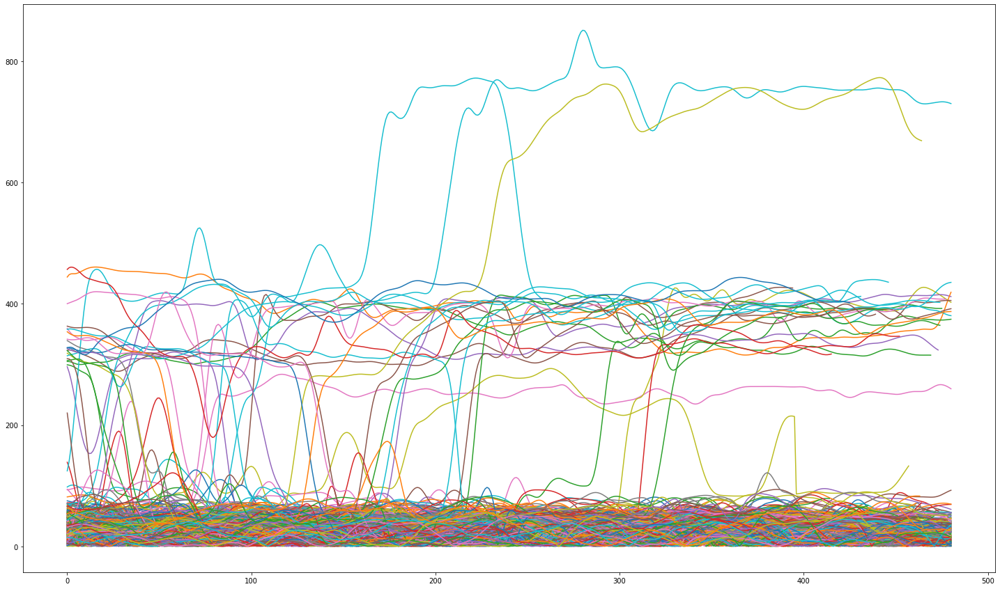

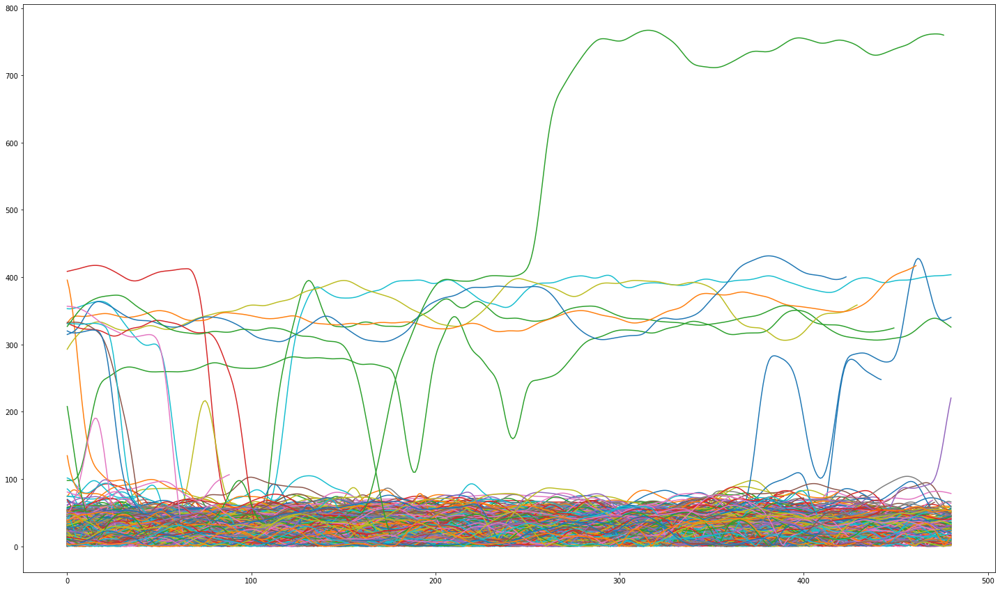

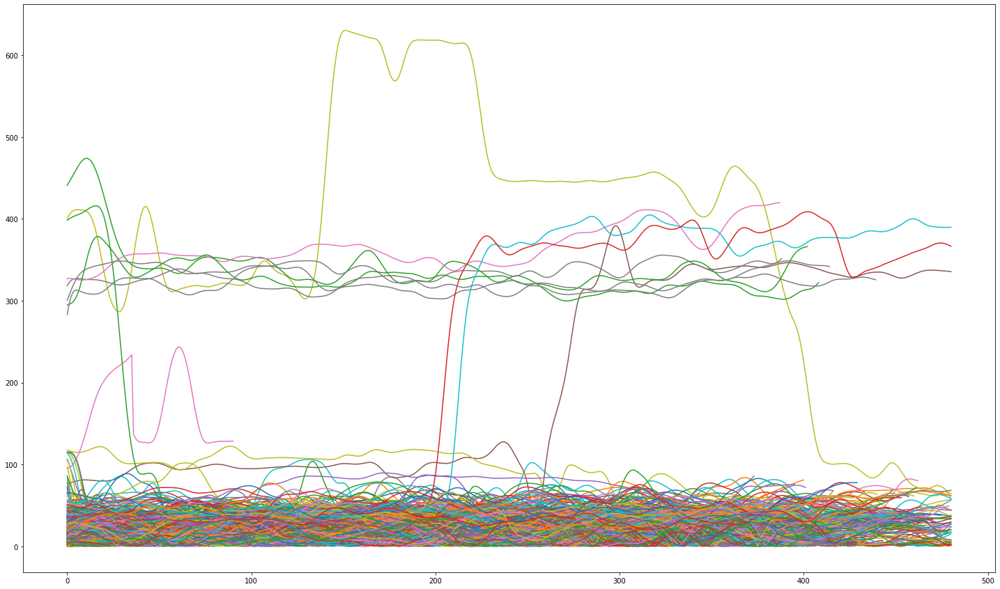

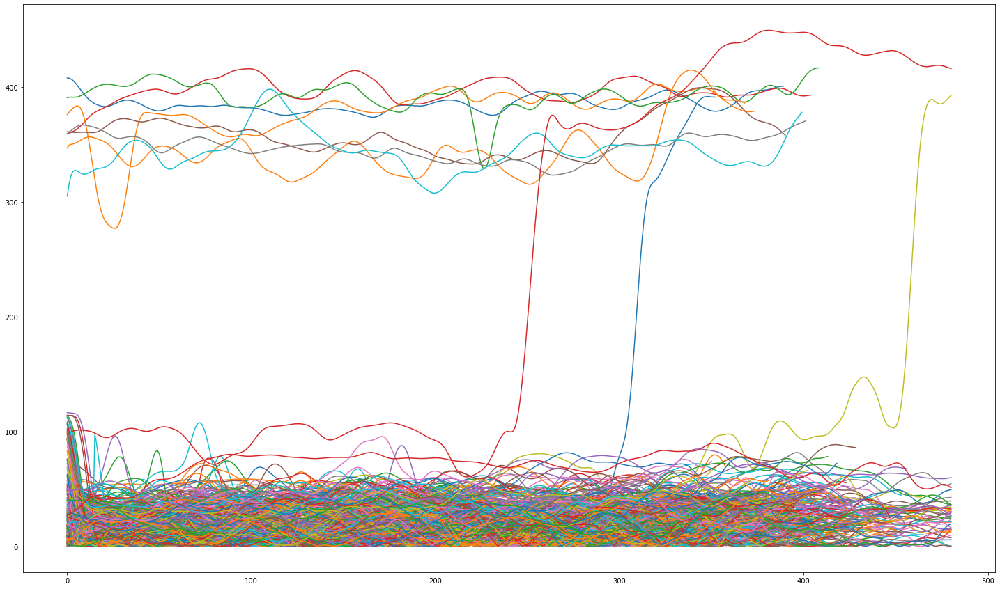

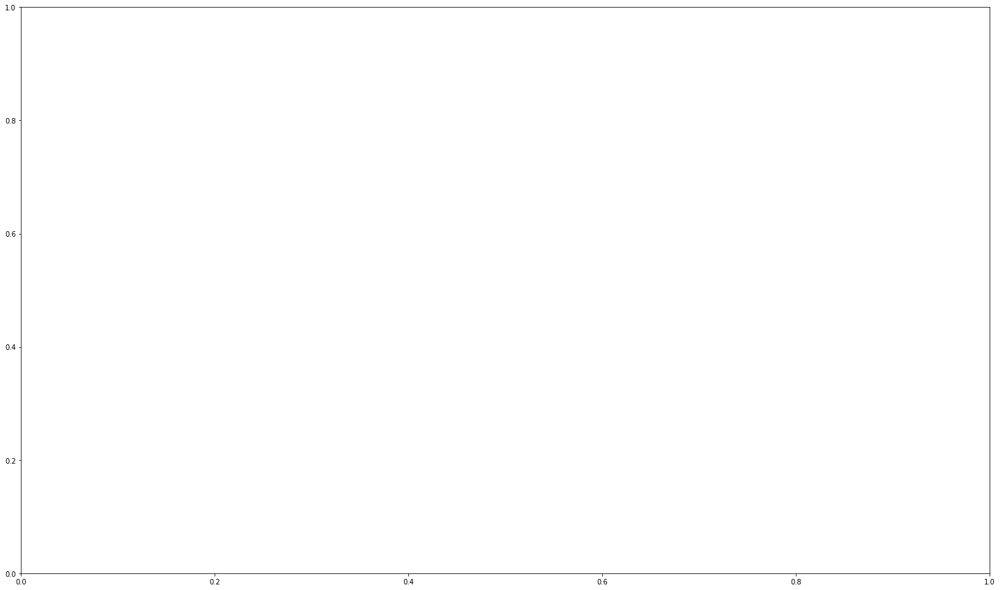

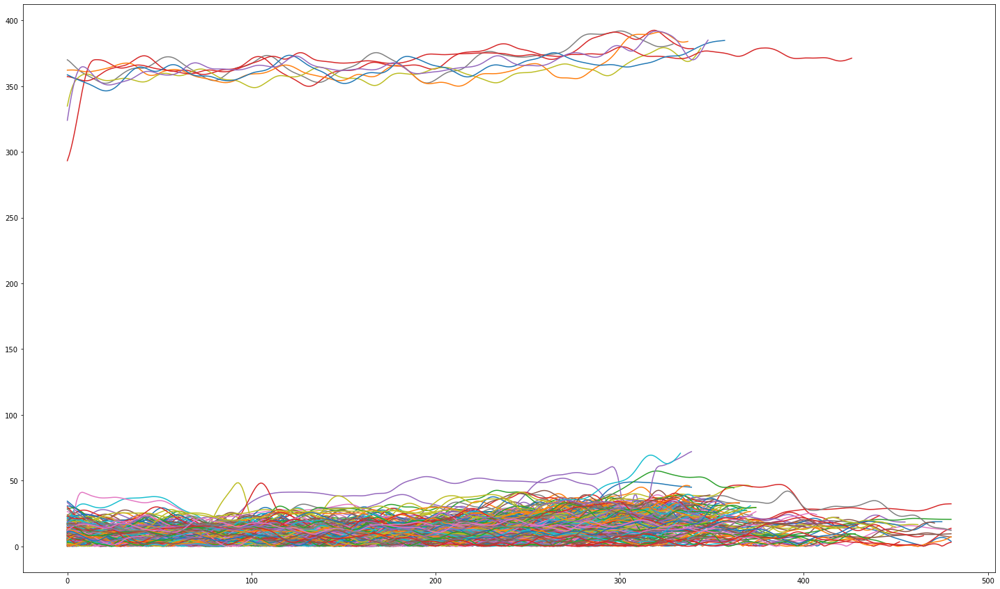

In [72]:
#Compute dict with TAtopcam angle only of non pert trials

search_key = ['4mm', '5mm', '8mm', '10mm', '15mm', '45mm']

dict_preprocessed_all_TA_topcam = defaultdict(dict)

for i in np.arange(len(search_key)):
    if i < 4:
        fig, ax1 = plt.subplots(1, 1, figsize=(25,15))
        dict_ridge = dict_ridge_all[search_key[i]]
        dict_ridge_ridge_pos = assign_dict_value_ridge_pos(dict_ridge)
        dict_ridge_el_pert_trial = eliminate_pert_trials_from_dict(dict_ridge_ridge_pos)
        dict_TA_transpose_btw_0_360_der_excluded_without_empty_array = extractTAtopcam(dict_ridge_el_pert_trial)#dict_TA_transpose_btw_0_360)
        dict_preprocessed_all_TA_topcam[search_key[i]] = dict_TA_transpose_btw_0_360_der_excluded_without_empty_array
    elif i >3:
        fig, ax1 = plt.subplots(1, 1, figsize=(25,15))
        dict_ridge = dict_ridge_all[search_key[i]]
        dict_TA_transpose_btw_0_360_der_excluded_without_empty_array = extractTAtopcam(dict_ridge)#dict_TA_transpose_btw_0_360)
        dict_preprocessed_all_TA_topcam[search_key[i]] = dict_TA_transpose_btw_0_360_der_excluded_without_empty_array